In [93]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.ticker as ticker

import geobr
import mapsmx as mp
import plotly.express as px 
import geopandas as gpd
import tensorflow as tf


In [3]:
data_path = 'data/'
customers_df = pd.read_csv(data_path + "olist_customers_dataset.csv")
geolocation_df = pd.read_csv(data_path + "olist_geolocation_dataset.csv")
order_items_df = pd.read_csv(data_path + "olist_order_items_dataset.csv")
order_payments_df = pd.read_csv(data_path + "olist_order_payments_dataset.csv")
order_reviews_df = pd.read_csv(data_path + "olist_order_reviews_dataset.csv")
orders_df = pd.read_csv(data_path + "olist_orders_dataset.csv")
products_df = pd.read_csv(data_path + "olist_products_dataset.csv")
sellers_df = pd.read_csv(data_path + "olist_sellers_dataset.csv")
product_category_name_translation_df = pd.read_csv(data_path + "product_category_name_translation.csv")

full_df = orders_df.merge(order_reviews_df, on='order_id')\
                   .merge(order_payments_df, on='order_id')\
                   .merge(customers_df, on='customer_id')\
                   .merge(order_items_df, on='order_id')\
                   .merge(products_df, on='product_id')\
                   .merge(sellers_df, on='seller_id')

full_df = full_df.drop_duplicates()

full_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,review_id,review_score,...,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,seller_city,seller_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,a54f0611adc9ed256b57ede6b6eb5114,4,...,40.0,268.0,4.0,500.0,19.0,8.0,13.0,9350,maua,SP
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,a54f0611adc9ed256b57ede6b6eb5114,4,...,40.0,268.0,4.0,500.0,19.0,8.0,13.0,9350,maua,SP
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,a54f0611adc9ed256b57ede6b6eb5114,4,...,40.0,268.0,4.0,500.0,19.0,8.0,13.0,9350,maua,SP
3,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-15 20:05:16,2017-08-17 15:28:33,2017-08-18 14:44:43,2017-08-28 00:00:00,b46f1e34512b0f4c74a72398b03ca788,4,...,40.0,268.0,4.0,500.0,19.0,8.0,13.0,9350,maua,SP
4,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,2017-08-02 18:43:15,2017-08-04 17:35:43,2017-08-07 18:30:01,2017-08-15 00:00:00,dc90f19c2806f1abba9e72ad3c350073,5,...,40.0,268.0,4.0,500.0,19.0,8.0,13.0,9350,maua,SP


In [4]:
full_df = full_df.assign(
    purchase_date = pd.to_datetime(full_df['order_purchase_timestamp']).dt.date,
    purchase_year = pd.to_datetime(full_df['order_purchase_timestamp']).dt.year,
    purchase_month = pd.to_datetime(full_df['order_purchase_timestamp']).dt.month,
    purchase_MMYYYY= pd.to_datetime(full_df['order_purchase_timestamp']).dt.strftime('%b-%y'),
    purchase_day = pd.to_datetime(full_df['order_purchase_timestamp']).dt.day_name(),
    purchase_hour = pd.to_datetime(full_df['order_purchase_timestamp']).dt.hour)
full_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,review_id,review_score,...,product_width_cm,seller_zip_code_prefix,seller_city,seller_state,purchase_date,purchase_year,purchase_month,purchase_MMYYYY,purchase_day,purchase_hour
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,a54f0611adc9ed256b57ede6b6eb5114,4,...,13.0,9350,maua,SP,2017-10-02,2017,10,Oct-17,Monday,10
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,a54f0611adc9ed256b57ede6b6eb5114,4,...,13.0,9350,maua,SP,2017-10-02,2017,10,Oct-17,Monday,10
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,a54f0611adc9ed256b57ede6b6eb5114,4,...,13.0,9350,maua,SP,2017-10-02,2017,10,Oct-17,Monday,10
3,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-15 20:05:16,2017-08-17 15:28:33,2017-08-18 14:44:43,2017-08-28 00:00:00,b46f1e34512b0f4c74a72398b03ca788,4,...,13.0,9350,maua,SP,2017-08-15,2017,8,Aug-17,Tuesday,18
4,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,2017-08-02 18:43:15,2017-08-04 17:35:43,2017-08-07 18:30:01,2017-08-15 00:00:00,dc90f19c2806f1abba9e72ad3c350073,5,...,13.0,9350,maua,SP,2017-08-02,2017,8,Aug-17,Wednesday,18


In [5]:
# Create an empty dataframe to store the results
na_counts = pd.DataFrame(columns=['column_name', 'na_count'])

# Iterate through each column of full_df
for col in full_df.columns:
    # Count the number of NA values in the column
    na_count = full_df[col].isna().sum()
    # Append a new row to na_counts with the column name and na_count
    #na_counts = na_counts.append({'column_name': col, 'na_count': na_count}, ignore_index=True)
    insert_row = {
    "column_name": col,
    "na_count": na_count }
    na_counts = pd.concat([na_counts, pd.DataFrame([insert_row])])



na_counts = full_df.agg(lambda x: x.isna().sum()).reset_index()
na_counts.columns = ['column_name', 'na_count']

def highlight_NaN(x):
    return ['color:darkblue;background-color:pink' if v > 0 else '' for v in x]

na_counts = na_counts.style.apply(highlight_NaN, subset=pd.IndexSlice[:, ["na_count"]])

na_counts

,column_name,na_count
0,order_id,0
1,customer_id,0
2,order_status,0
3,order_purchase_timestamp,0
4,order_approved_at,15
5,order_delivered_carrier_date,1235
6,order_delivered_customer_date,2471
7,order_estimated_delivery_date,0
8,review_id,0
9,review_score,0


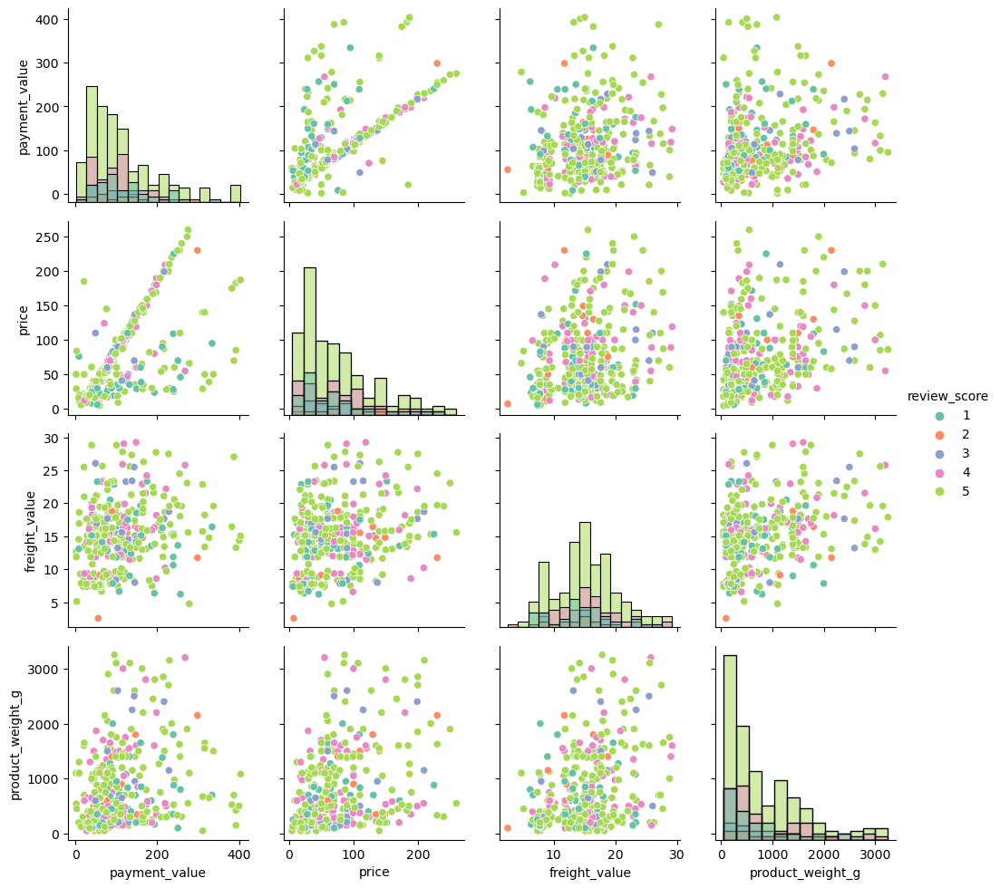

In [6]:
# Grab the columns we want to focus on to draw scatterplots and histograms
filtered_df = full_df[['payment_value', 'price', 'freight_value', 'product_weight_g', 'review_score']].sample(500, random_state=69)

# Define the list of columns you want to calculate the IQR for
columns_to_remove_outliers = ['payment_value', 'price', 'freight_value', 'product_weight_g']

for column in columns_to_remove_outliers:
    # Calculate the quartiles of the column
    q1 = filtered_df[column].quantile(0.25)
    q3 = filtered_df[column].quantile(0.75)

    # Calculate the IQR
    iqr = q3 - q1

    # Calculate the lower and upper bounds
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr

    # Remove rows that fall outside the IQR
    filtered_df = filtered_df[(filtered_df[column] >= lower_bound) & (filtered_df[column] <= upper_bound)]
# This code first defines a list of columns columns_to_remove_outliers that you want to calculate the IQR for. Then, it uses a for loop to iterate over the list of columns. For each column, it calculates the first (q1) and third quart


# Leverage Seaborn's PairGrid method to create a grid pattern for the plots
g = sns.PairGrid(filtered_df, hue="review_score", palette="Set2")
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)
g.add_legend()

In [7]:
full_df.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'review_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'customer_unique_id',
       'customer_zip_code_prefix', 'customer_city', 'customer_state',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'purchase_date', 'purchase_year',
       'purchase_month', 'purchase_MMYYYY', 'purchas

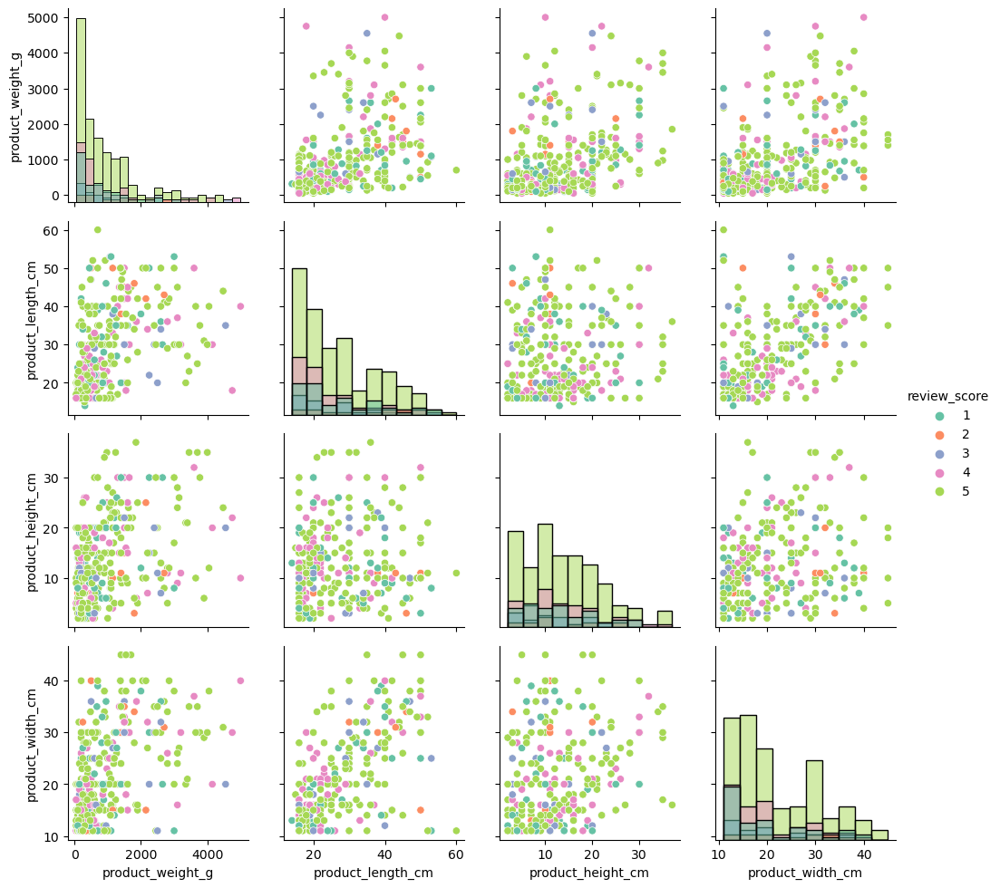

In [8]:
# Grab the columns we want to focus on to draw scatterplots and histograms
filtered_df = full_df[['product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', "review_score"]].sample(500, random_state=69)

# Define the list of columns you want to calculate the IQR for
columns_to_remove_outliers = ['product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm']

for column in columns_to_remove_outliers:
    # Calculate the quartiles of the column
    q1 = filtered_df[column].quantile(0.25)
    q3 = filtered_df[column].quantile(0.75)

    # Calculate the IQR
    iqr = q3 - q1

    # Calculate the lower and upper bounds
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr

    # Remove rows that fall outside the IQR
    filtered_df = filtered_df[(filtered_df[column] >= lower_bound) & (filtered_df[column] <= upper_bound)]
# This code first defines a list of columns columns_to_remove_outliers that you want to calculate the IQR for. Then, it uses a for loop to iterate over the list of columns. For each column, it calculates the first (q1) and third quart


# Leverage Seaborn's PairGrid method to create a grid pattern for the plots
g = sns.PairGrid(filtered_df, palette="Set2", hue="review_score")
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)
g.add_legend()

In [9]:
from datetime import datetime

#full_df = full_df.dropna()

full_df['order_delivered_customer_date'] = pd.to_datetime(full_df['order_delivered_customer_date'])#full_df['order_delivered_customer_date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d %H:%M:%S'))
full_df['order_estimated_delivery_date'] = pd.to_datetime(full_df['order_estimated_delivery_date'])
# full_df['elapsed_time_est_deliv'] = 
full_df['elapsed_deliv_estim_days'] = (full_df['order_estimated_delivery_date'] - full_df['order_delivered_customer_date']).dt.days


<AxesSubplot:xlabel='elapsed_deliv_estim_days', ylabel='Count'>

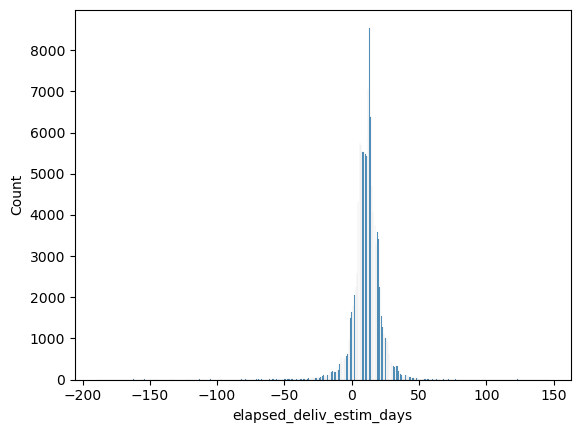

In [10]:
sns.histplot(full_df['elapsed_deliv_estim_days'])

In [11]:
full_df.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'review_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'customer_unique_id',
       'customer_zip_code_prefix', 'customer_city', 'customer_state',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'purchase_date', 'purchase_year',
       'purchase_month', 'purchase_MMYYYY', 'purchas

In [12]:
full_df.groupby('seller_id').size().sort_values(ascending=False)[0:10].to_frame().reset_index()['seller_id']

0    4a3ca9315b744ce9f8e9374361493884
1    6560211a19b47992c3666cc44a7e94c0
2    1f50f920176fa81dab994f9023523100
3    cc419e0650a3c5ba77189a1882b7556a
4    da8622b14eb17ae2831f4ac5b9dab84a
5    955fee9216a65b617aa5c0531780ce60
6    1025f0e2d44d7041d6cf58b6550e0bfa
7    7c67e1448b00f6e969d365cea6b010ab
8    7a67c85e85bb2ce8582c35f2203ad736
9    ea8482cd71df3c1969d7b9473ff13abc
Name: seller_id, dtype: object

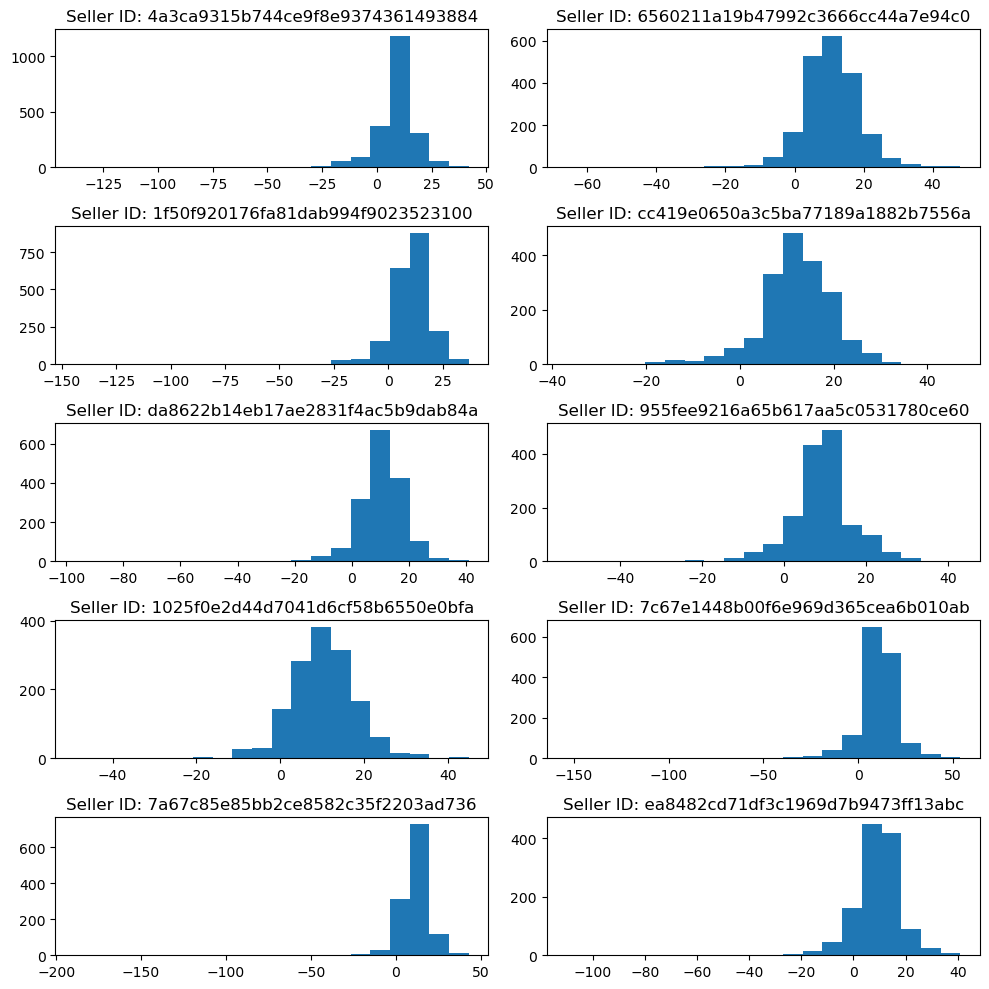

In [13]:
# Create a list of unique seller IDs
#seller_ids = full_df["seller_id"].unique()
seller_ids = full_df.groupby('seller_id').size().sort_values(ascending=False)[0:10].to_frame().reset_index()['seller_id']

# Set up the grid of histograms
fig, axes = plt.subplots(len(seller_ids)//2 + len(seller_ids) % 2, 2, figsize=(10,10))
axes = axes.ravel()

# Plot a histogram for each unique seller ID
for i, seller_id in enumerate(seller_ids):
    data = full_df[full_df["seller_id"] == seller_id]["elapsed_deliv_estim_days"]
    axes[i].hist(data, bins=20)
    axes[i].set_title(f"Seller ID: {seller_id}")

plt.tight_layout()
plt.show()

In [14]:
import plotly.express as px

# Assume the DataFrame is called 'full_df' and contains a column called 'state' with the state names
# and a column called 'review_value' with the review values

# Calculate the average review value for each state
state_reviews = full_df.groupby('seller_state')['review_score'].mean()

# Create a choropleth map
fig = px.choropleth(state_reviews,
                    locations='review_score',
                    locationmode='country names',
                    color='review_score',
                    title='Average Review Value by State in Brazil',
                    hover_name='review_score',
                    range_color=[state_reviews.min(), state_reviews.max()],
                    color_continuous_scale='Viridis')

fig.show()

In [15]:
states = geobr.read_state(year=2016)
# municipalities = geobr.read_municipality(year=2016)
# all_muni = geobr.read_municipality(code_muni="RJ", year=2016)
# sp_muni = geobr.read_municipality(code_muni="SP", year=2016)

/Users/aydensalazar/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:93: ShapelyDeprecationWarning:

__len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.

/Users/aydensalazar/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:93: ShapelyDeprecationWarning:

__len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.

/Users/aydensalazar/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:93: ShapelyDeprecationWarning:

__len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.

/Users/aydensalazar/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:93: ShapelyDepre

In [16]:
#states["abbrev_state"] = states["abbrev_state"].str.lower()
customers_df_state=customers_df.groupby(by='customer_state')[['customer_id']].count().reset_index()
#customers_df_state['customer_state'] = customers_df_state['customer_state'].str.lower()

# join geo with data
states_n = states.merge(customers_df_state, left_on="abbrev_state", right_on="customer_state")
states_n=states_n.rename(columns={'customer_id':'Numbers'})
fig = px.choropleth(states_n, geojson=states_n['geometry'], 
                    locations=states_n.index, color="Numbers",
                    height=500,
                    hover_name='abbrev_state',
                    labels = {'name_state' : 'Numbers'}, 
                    title = 'Numbers of customers across states',
                   color_continuous_scale="Viridis")
fig.update_geos(fitbounds="locations", visible=True)
fig.update_layout(
    title={'text':'Numbers of customers across states',
            'x':0.5,
            'xanchor': 'center'}
)
fig.show()

In [17]:
customers_df_state

,customer_state,customer_id
0,AC,81
1,AL,413
2,AM,148
3,AP,68
4,BA,3380
5,CE,1336
6,DF,2140
7,ES,2033
8,GO,2020
9,MA,747


In [18]:
states

,code_state,abbrev_state,name_state,code_region,name_region,geometry
0,11.0,RO,Rondônia,1.0,Norte,"MULTIPOLYGON (((-62.86662 -7.97587, -62.85336 ..."
1,12.0,AC,Acre,1.0,Norte,"MULTIPOLYGON (((-73.18253 -7.33550, -72.58477 ..."
2,13.0,AM,Amazonas,1.0,Norte,"MULTIPOLYGON (((-67.32609 2.02971, -67.31682 2..."
3,14.0,RR,Roraima,1.0,Norte,"MULTIPOLYGON (((-60.20051 5.26434, -60.19273 5..."
4,15.0,PA,Pará,1.0,Norte,"MULTIPOLYGON (((-46.06095 -1.09470, -46.06666 ..."
5,16.0,AP,Amapá,1.0,Norte,"MULTIPOLYGON (((-50.18123 1.90099, -50.17688 1..."
6,17.0,TO,Tocantins,1.0,Norte,"MULTIPOLYGON (((-48.35878 -5.17008, -48.33846 ..."
7,21.0,MA,Maranhão,2.0,Nordeste,"MULTIPOLYGON (((-43.99913 -2.39272, -43.99737 ..."
8,22.0,PI,Piauí,2.0,Nordeste,"MULTIPOLYGON (((-41.74605 -2.80350, -41.73488 ..."
9,23.0,CE,Ceará,2.0,Nordeste,"MULTIPOLYGON (((-40.49717 -2.78451, -40.48429 ..."


In [19]:
full_df.groupby('customer_state').mean()['review_score'].to_frame().reset_index()

,customer_state,review_score
0,AC,4.094737
1,AL,3.718954
2,AM,4.082353
3,AP,4.240964
4,BA,3.819631
5,CE,3.823301
6,DF,4.002820
7,ES,3.985770
8,GO,3.986755
9,MA,3.682088


In [20]:
#states["abbrev_state"] = states["abbrev_state"].str.lower()
avg_rating_df_state = full_df.groupby('customer_state').mean()['review_score'].to_frame().reset_index()
avg_rating_df_state = avg_rating_df_state.rename(columns={'review_score':'avg_review_score'})

#customers_df_state['customer_state'] = customers_df_state['customer_state'].str.lower()

# join geo with data
states_n = states.merge(avg_rating_df_state, left_on="abbrev_state", right_on="customer_state")
fig = px.choropleth(states_n, geojson=states_n['geometry'], 
                    locations=states_n.index, color="avg_review_score",
                    height=500,
                    hover_name='abbrev_state',
                    labels = {'name_state' : 'avg_review_score'}, 
                    title = 'Average Review Score For Each State',
                   color_continuous_scale="Viridis")
fig.update_geos(fitbounds="locations", visible=True)
fig.update_layout(
    title={'text':'Average Review Score For Each State',
            'x':0.5,
            'xanchor': 'center'}
)
fig.show()

In [21]:
full_df

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,review_id,review_score,...,seller_zip_code_prefix,seller_city,seller_state,purchase_date,purchase_year,purchase_month,purchase_MMYYYY,purchase_day,purchase_hour,elapsed_deliv_estim_days
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,a54f0611adc9ed256b57ede6b6eb5114,4,...,9350,maua,SP,2017-10-02,2017,10,Oct-17,Monday,10,7.0
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,a54f0611adc9ed256b57ede6b6eb5114,4,...,9350,maua,SP,2017-10-02,2017,10,Oct-17,Monday,10,7.0
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,a54f0611adc9ed256b57ede6b6eb5114,4,...,9350,maua,SP,2017-10-02,2017,10,Oct-17,Monday,10,7.0
3,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-15 20:05:16,2017-08-17 15:28:33,2017-08-18 14:44:43,2017-08-28,b46f1e34512b0f4c74a72398b03ca788,4,...,9350,maua,SP,2017-08-15,2017,8,Aug-17,Tuesday,18,9.0
4,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,2017-08-02 18:43:15,2017-08-04 17:35:43,2017-08-07 18:30:01,2017-08-15,dc90f19c2806f1abba9e72ad3c350073,5,...,9350,maua,SP,2017-08-02,2017,8,Aug-17,Wednesday,18,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117324,1ab38815794efa43d269d62b98dae815,a0b67404d84a70ef420a7f99ad6b190a,delivered,2018-07-01 10:23:10,2018-07-05 16:17:52,2018-07-04 14:34:00,2018-07-09 15:06:57,2018-07-20,7f9849fcbfdf9fa3070c05b5501bf066,5,...,13660,porto ferreira,SP,2018-07-01,2018,7,Jul-18,Sunday,10,10.0
117325,b159d0ce7cd881052da94fa165617b05,e0c3bc5ce0836b975d6b2a8ce7bb0e3e,canceled,2017-03-11 19:51:36,2017-03-11 19:51:36,NaN,NaT,2017-03-30,c950324a42c5796d06f569f77d8b2e88,1,...,89031,blumenau,SC,2017-03-11,2017,3,Mar-17,Saturday,19,NaN
117326,735dce2d574afe8eb87e80a3d6229c48,d531d01affc2c55769f6b9ed410d8d3c,delivered,2018-07-24 09:46:27,2018-07-24 11:24:27,2018-07-24 15:14:00,2018-08-02 22:47:35,2018-08-16,19f21ead7ffe5b1b5147a7877c22bae5,5,...,13478,americana,SP,2018-07-24,2018,7,Jul-18,Tuesday,9,13.0
117327,25d2bfa43663a23586afd12f15b542e7,9d8c06734fde9823ace11a4b5929b5a7,delivered,2018-05-22 21:13:21,2018-05-22 21:35:40,2018-05-24 12:28:00,2018-06-12 23:11:29,2018-06-08,ec2817e750153dfdd61894780dfc5d9e,4,...,8320,sao paulo,SP,2018-05-22,2018,5,May-18,Tuesday,21,-5.0


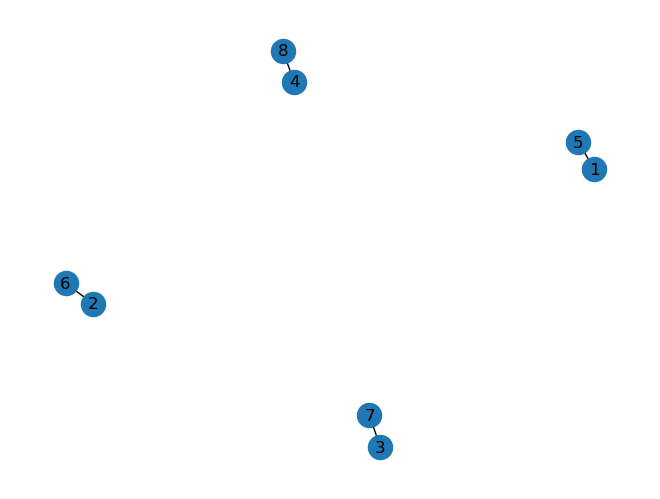

In [22]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd

# Create a sample DataFrame
df = pd.DataFrame({'seller_id': [1, 2, 3, 4], 'customer_id': [5, 6, 7, 8]})

# Create a Graph object
G = nx.Graph()

# Add edges to the graph
for i, row in df.iterrows():
    G.add_edge(row['seller_id'], row['customer_id'])

# Draw the graph
nx.draw(G, with_labels=True)
plt.show()

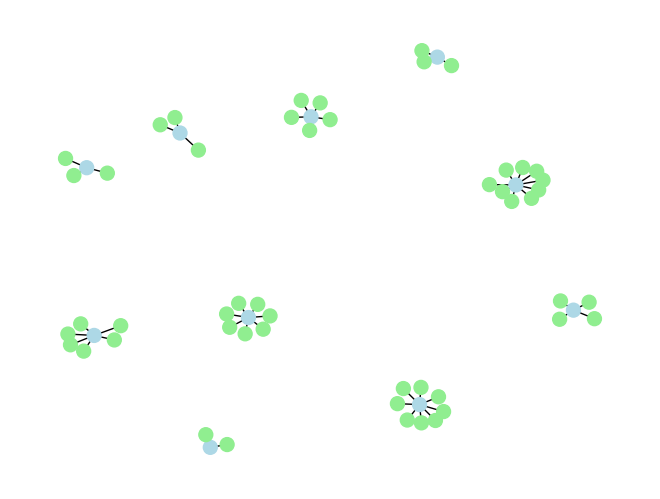

In [23]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd

# Create a sample DataFrame
seller_list = full_df.groupby('seller_id').size().sort_values(ascending=False)[0:10].to_frame().reset_index()['seller_id'].to_list()
filtered_seller_df = full_df[full_df['seller_id'].isin(seller_list)]
sample_df = filtered_seller_df.sample(50, random_state=69)
# customer_list = full_df.groupby('customer_id').size().sort_values(ascending=False)[0:10].to_frame().reset_index()['customer_id'].to_list()
# filtered_customer_df = full_df[full_df['customer_id'].isin(customer_list)]
# sample_df = filtered_customer_df.sample(50, random_state=69)

# Create a Graph object
G = nx.Graph()

# Add edges to the graph
for i, row in sample_df.iterrows():
    G.add_edge(row['seller_id'], row['customer_id'])

colors = []
for node in G:
    if node in sample_df["seller_id"].values:
        colors.append("lightblue")
    else:
        colors.append("lightgreen")

# Draw the graph
nx.draw(G, with_labels=False, node_color=colors, node_size=100)
plt.show()

In [24]:
#seller_ids = full_df.groupby('seller_id').size().sort_values(ascending=False)[0:10].to_frame().reset_index()['seller_id']
customer_list = full_df.groupby('customer_id').size().sort_values(ascending=False)[0:10].to_frame().reset_index()['customer_id'].to_list()
filtered_customer_df = full_df[full_df['customer_id'].isin(customer_list)]
filtered_customer_df


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,review_id,review_score,...,seller_zip_code_prefix,seller_city,seller_state,purchase_date,purchase_year,purchase_month,purchase_MMYYYY,purchase_day,purchase_hour,elapsed_deliv_estim_days
4304,fedcd9f7ccdc8cba3a18defedd1a5547,13aa59158da63ba0e93ec6ac2c07aacb,delivered,2017-09-23 14:56:45,2017-09-25 17:44:41,2017-10-02 23:47:54,2017-10-18 22:35:50,2017-10-23,7145a6f0d38ec713897856cbdcfcdb7f,5,...,8577,itaquaquecetuba,SP,2017-09-23,2017,9,Sep-17,Saturday,14,4.0
4305,fedcd9f7ccdc8cba3a18defedd1a5547,13aa59158da63ba0e93ec6ac2c07aacb,delivered,2017-09-23 14:56:45,2017-09-25 17:44:41,2017-10-02 23:47:54,2017-10-18 22:35:50,2017-10-23,7145a6f0d38ec713897856cbdcfcdb7f,5,...,8577,itaquaquecetuba,SP,2017-09-23,2017,9,Sep-17,Saturday,14,4.0
4306,fedcd9f7ccdc8cba3a18defedd1a5547,13aa59158da63ba0e93ec6ac2c07aacb,delivered,2017-09-23 14:56:45,2017-09-25 17:44:41,2017-10-02 23:47:54,2017-10-18 22:35:50,2017-10-23,7145a6f0d38ec713897856cbdcfcdb7f,5,...,8577,itaquaquecetuba,SP,2017-09-23,2017,9,Sep-17,Saturday,14,4.0
4307,fedcd9f7ccdc8cba3a18defedd1a5547,13aa59158da63ba0e93ec6ac2c07aacb,delivered,2017-09-23 14:56:45,2017-09-25 17:44:41,2017-10-02 23:47:54,2017-10-18 22:35:50,2017-10-23,7145a6f0d38ec713897856cbdcfcdb7f,5,...,8577,itaquaquecetuba,SP,2017-09-23,2017,9,Sep-17,Saturday,14,4.0
4308,fedcd9f7ccdc8cba3a18defedd1a5547,13aa59158da63ba0e93ec6ac2c07aacb,delivered,2017-09-23 14:56:45,2017-09-25 17:44:41,2017-10-02 23:47:54,2017-10-18 22:35:50,2017-10-23,7145a6f0d38ec713897856cbdcfcdb7f,5,...,8577,itaquaquecetuba,SP,2017-09-23,2017,9,Sep-17,Saturday,14,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111756,c6492b842ac190db807c15aff21a7dd6,6ee2f17e3b6c33d6a9557f280edd2925,delivered,2017-03-09 23:39:26,2017-03-09 23:39:26,2017-03-15 11:16:33,2017-03-21 13:32:45,2017-03-30,cc074f1c33940c4f0dd904705f98e39e,4,...,38405,uberlandia,MG,2017-03-09,2017,3,Mar-17,Thursday,23,8.0
111757,c6492b842ac190db807c15aff21a7dd6,6ee2f17e3b6c33d6a9557f280edd2925,delivered,2017-03-09 23:39:26,2017-03-09 23:39:26,2017-03-15 11:16:33,2017-03-21 13:32:45,2017-03-30,cc074f1c33940c4f0dd904705f98e39e,4,...,38405,uberlandia,MG,2017-03-09,2017,3,Mar-17,Thursday,23,8.0
111758,c6492b842ac190db807c15aff21a7dd6,6ee2f17e3b6c33d6a9557f280edd2925,delivered,2017-03-09 23:39:26,2017-03-09 23:39:26,2017-03-15 11:16:33,2017-03-21 13:32:45,2017-03-30,cc074f1c33940c4f0dd904705f98e39e,4,...,38405,uberlandia,MG,2017-03-09,2017,3,Mar-17,Thursday,23,8.0
111759,c6492b842ac190db807c15aff21a7dd6,6ee2f17e3b6c33d6a9557f280edd2925,delivered,2017-03-09 23:39:26,2017-03-09 23:39:26,2017-03-15 11:16:33,2017-03-21 13:32:45,2017-03-30,cc074f1c33940c4f0dd904705f98e39e,4,...,38405,uberlandia,MG,2017-03-09,2017,3,Mar-17,Thursday,23,8.0


In [25]:
full_df['product_category_name'].value_counts()

cama_mesa_banho                  11847
beleza_saude                      9944
esporte_lazer                     8942
moveis_decoracao                  8743
informatica_acessorios            8105
                                 ...  
la_cuisine                          15
cds_dvds_musicais                   14
pc_gamer                            10
fashion_roupa_infanto_juvenil        8
seguros_e_servicos                   2
Name: product_category_name, Length: 73, dtype: int64

In [26]:
pivot_revenue =full_df.pivot_table(values = ['order_id', 'price']
                              , index=['purchase_year','purchase_month','purchase_MMYYYY']
                              , aggfunc={'order_id':'nunique','price':'sum'})
pivot_revenue = pivot_revenue.reset_index().iloc[3:23]                              
pivot_revenue

,purchase_year,purchase_month,purchase_MMYYYY,order_id,price
3,2017,1,Jan-17,779,128589.06
4,2017,2,Feb-17,1722,259477.98
5,2017,3,Mar-17,2621,392081.04
6,2017,4,Apr-17,2374,389909.32
7,2017,5,May-17,3626,544303.13
8,2017,6,Jun-17,3192,453843.43
9,2017,7,Jul-17,3934,531931.73
10,2017,8,Aug-17,4261,599081.06
11,2017,9,Sep-17,4209,660526.82
12,2017,10,Oct-17,4530,689624.82


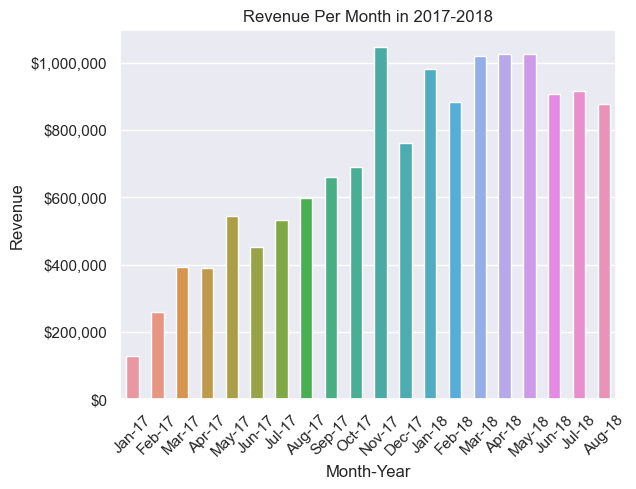

In [27]:
import seaborn as sns
import matplotlib.ticker as ticker

sns.set_theme(style="darkgrid")

# Plot the responses for different events and regions
g = sns.barplot(x="purchase_MMYYYY", y="price",
             data=pivot_revenue, width=0.5)
#g.set(yscale='log')
plt.xticks(rotation=45)
plt.ylabel("Revenue")
plt.xlabel("Month-Year")
plt.title("Revenue Per Month in 2017-2018")
g.yaxis.set_major_formatter(ticker.StrMethodFormatter('${x:,.0f}'))


Text(0.5, 1.0, 'Total Number of Orders By Day')

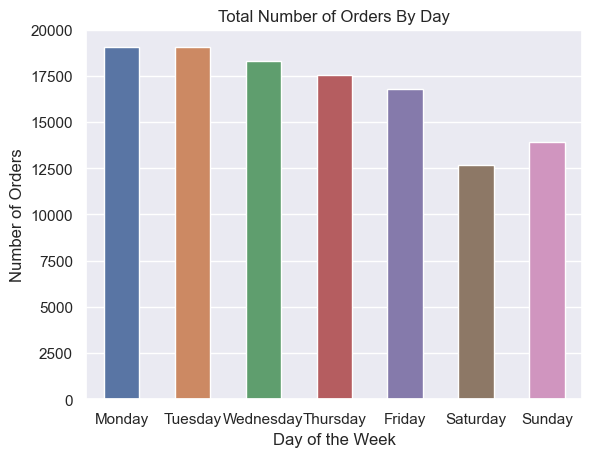

In [28]:
purchase_day = full_df.groupby("purchase_day").size().to_frame()

day_of_wk = ['Monday', 'Tuesday', 'Wednesday','Thursday','Friday','Saturday','Sunday']
purchase_day = purchase_day.reindex(day_of_wk, axis=0).reset_index()

# from pandas.api.types import CategoricalDtype
# cat_type = CategoricalDtype(categories=cats, ordered=True)
# purchase_day['purchase_day'] = purchase_day['purchase_day'].astype(cat_type)




sns.set_theme(style="darkgrid")

# Plot the responses for different events and regions
g = sns.barplot(x="purchase_day", y=0,
             data=purchase_day, width=0.5)

plt.xlabel("Day of the Week")
plt.ylabel("Number of Orders")
plt.title("Total Number of Orders By Day")

Note:

Morning = 5:00 to before 12:00
Afternoon = 12:00 to before 17:00
Evening = 17:00 to before 21:00
Night = 21:00 to before 4:00

In [29]:
# Note:
# Morning = 5:00 to before 12:00
# Afternoon = 12:00 to before 17:00
# Evening = 17:00 to before 21:00
# Night = 21:00 to before 4:00


# Create the bins for each time range
bins = [pd.to_datetime('0:00').hour, pd.to_datetime('5:00').hour, pd.to_datetime('12:00').hour, pd.to_datetime('17:00').hour, pd.to_datetime('21:00').hour, pd.to_datetime('23:59:59.999999').hour]

# Create the labels for each bin
labels = ['Night', 'Morning', 'Afternoon', 'Evening', 'Night']

# Convert the order_time column to datetime if it's not already
full_df['order_purchase_timestamp_hour'] = full_df['order_purchase_timestamp'].apply(lambda x: pd.to_datetime(x).hour)

# Create the new column with the binned time ranges
full_df['time_range'] = pd.cut(full_df['order_purchase_timestamp_hour'], bins=bins, labels=labels, ordered=False)

In [30]:
pivot_order =full_df.pivot_table(values = ['order_id']
                              , index=['purchase_day','time_range']
                              , aggfunc={'order_id':'nunique'})
pivot_order                            

order_id
purchase_day time_range          
Friday       Afternoon       4666
             Evening         2917
             Morning         4311
             Night           1600
Monday       Afternoon       5197
             Evening         3954
             Morning         4494
             Night           1958
Saturday     Afternoon       3456
             Evening         2805
             Morning         2851
             Night           1290
Sunday       Afternoon       3587
             Evening         3604
             Morning         2598
             Night           1765
Thursday     Afternoon       4806
             Evening         3244
             Morning         4414
             Night           1723
Tuesday      Afternoon       5180
             Evening         3765
             Morning         4529
             Night           1948
Wednesday    Afternoon       4991
             Evening         3496
             Morning         4597
             Night           1820

In [31]:
pivot_order = pivot_order.reset_index().pivot("purchase_day", "time_range", "order_id")
# cat_type = CategoricalDtype(categories=cats, ordered=True)
# pivot_revenue['purchase_day'] = pivot_revenue['purchase_day'].astype(cat_type)

#.pivot("purchase_day", "time_range", "order_id")

pivot_order


time_range,Afternoon,Evening,Morning,Night
purchase_day,,,,
Friday,4666,2917,4311,1600
Monday,5197,3954,4494,1958
Saturday,3456,2805,2851,1290
Sunday,3587,3604,2598,1765
Thursday,4806,3244,4414,1723
Tuesday,5180,3765,4529,1948
Wednesday,4991,3496,4597,1820


In [32]:
day_of_wk = ['Monday', 'Tuesday', 'Wednesday','Thursday','Friday','Saturday','Sunday']
time_of_day = ['Morning', 'Afternoon', 'Evening', 'Night']
pivot_order = pivot_order.reindex(day_of_wk, axis=0)
pivot_order = pivot_order.reindex(time_of_day, axis=1)
pivot_order

time_range,Morning,Afternoon,Evening,Night
purchase_day,,,,
Monday,4494,5197,3954,1958
Tuesday,4529,5180,3765,1948
Wednesday,4597,4991,3496,1820
Thursday,4414,4806,3244,1723
Friday,4311,4666,2917,1600
Saturday,2851,3456,2805,1290
Sunday,2598,3587,3604,1765


Text(47.24999999999999, 0.5, 'Day of Week')

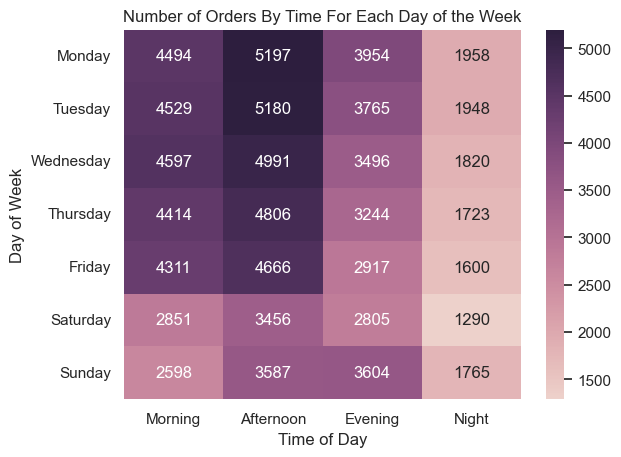

In [33]:
sns.heatmap(pivot_order, annot=True, cmap=sns.cubehelix_palette(as_cmap=True), fmt='g')
plt.title("Number of Orders By Time For Each Day of the Week")
plt.xlabel("Time of Day")
plt.ylabel("Day of Week")

Text(47.24999999999999, 0.5, 'Day of Week')

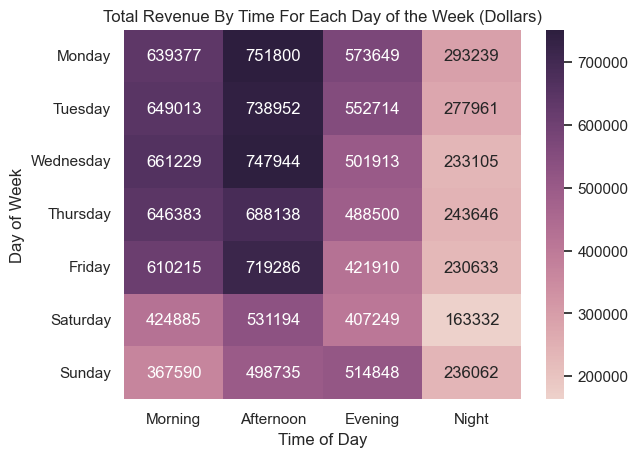

In [34]:
pivot_revenue_day_time = full_df.pivot_table(values = ['price']
                              , index=['purchase_day','time_range']
                              , aggfunc={'price':'sum'})

pivot_revenue_day_time = pivot_revenue_day_time.reset_index().pivot("purchase_day", "time_range", "price")

day_of_wk = ['Monday', 'Tuesday', 'Wednesday','Thursday','Friday','Saturday','Sunday']
time_of_day = ['Morning', 'Afternoon', 'Evening', 'Night']
pivot_revenue_day_time = pivot_revenue_day_time.reindex(day_of_wk, axis=0)
pivot_revenue_day_time = pivot_revenue_day_time.reindex(time_of_day, axis=1)


sns.heatmap(pivot_revenue_day_time, annot=True, cmap=sns.cubehelix_palette(as_cmap=True), fmt='g')
plt.title("Total Revenue By Time For Each Day of the Week (Dollars)")
plt.xlabel("Time of Day")
plt.ylabel("Day of Week")
 

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 [Text(0, 0, 'cama_mesa_banho'),
  Text(1, 0, 'beleza_saude'),
  Text(2, 0, 'esporte_lazer'),
  Text(3, 0, 'moveis_decoracao'),
  Text(4, 0, 'informatica_acessorios'),
  Text(5, 0, 'utilidades_domesticas'),
  Text(6, 0, 'relogios_presentes'),
  Text(7, 0, 'telefonia'),
  Text(8, 0, 'ferramentas_jardim'),
  Text(9, 0, 'automotivo'),
  Text(10, 0, 'brinquedos'),
  Text(11, 0, 'cool_stuff'),
  Text(12, 0, 'perfumaria'),
  Text(13, 0, 'bebes'),
  Text(14, 0, 'eletronicos'),
  Text(15, 0, 'papelaria'),
  Text(16, 0, 'fashion_bolsas_e_acessorios'),
  Text(17, 0, 'pet_shop'),
  Text(18, 0, 'moveis_escritorio'),
  Text(19, 0, 'consoles_games')])

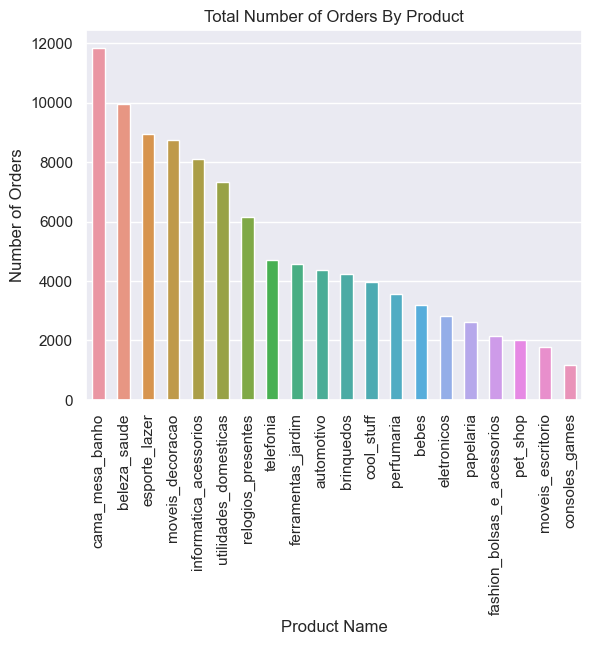

In [35]:
most_pop_categories = full_df.groupby('product_category_name').size().to_frame().reset_index().sort_values(0, ascending=False).iloc[0:20, :]

sns.set_theme(style="darkgrid")

# Plot the responses for different events and regions
g = sns.barplot(x="product_category_name", y=0,
             data=most_pop_categories, width=0.5)

plt.xlabel("Product Name")
plt.ylabel("Number of Orders")
plt.title("Total Number of Orders By Product")
plt.xticks(rotation=90)

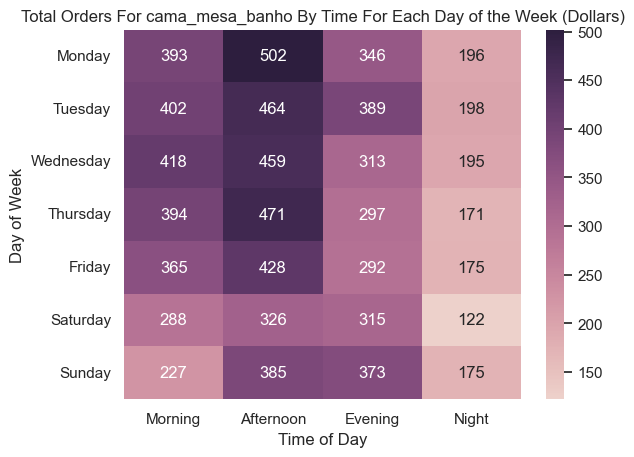

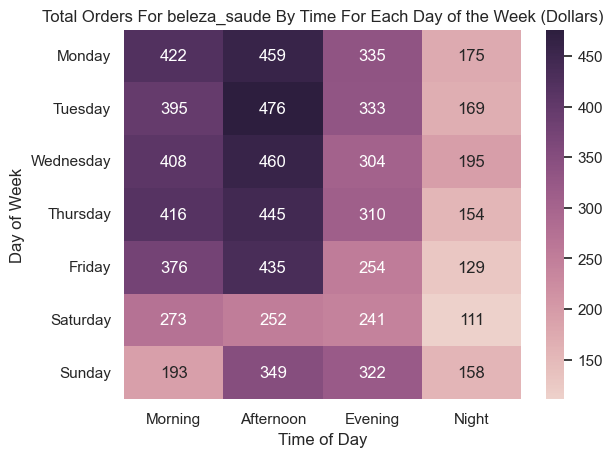

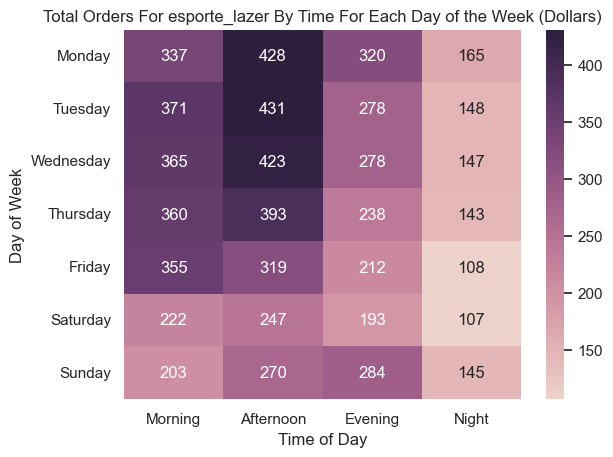

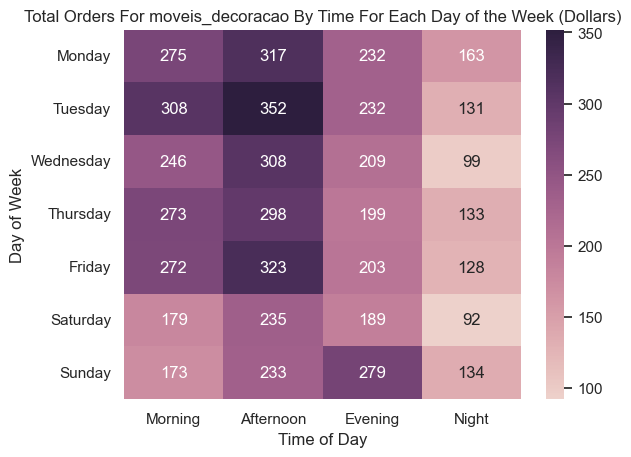

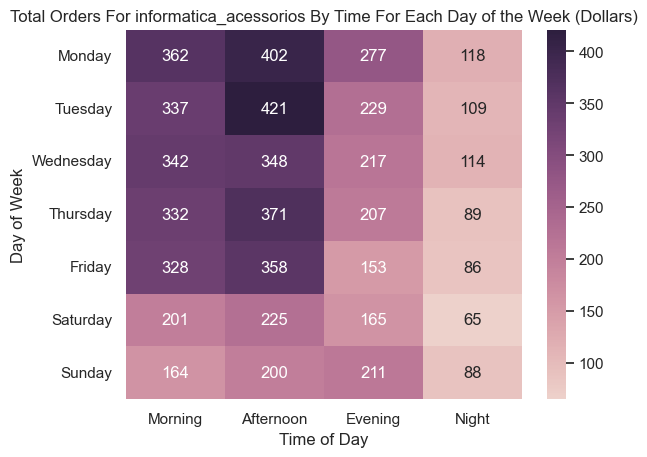

...

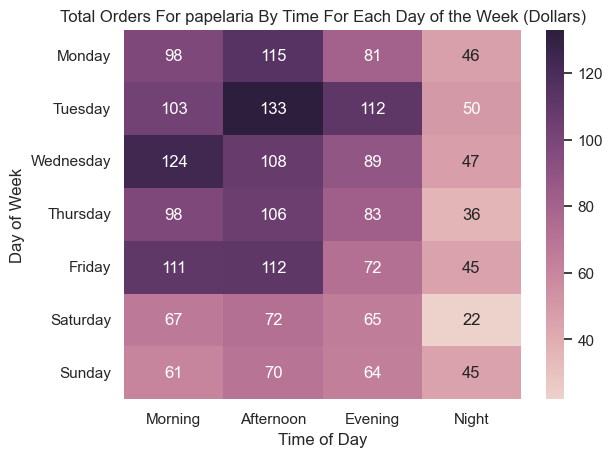

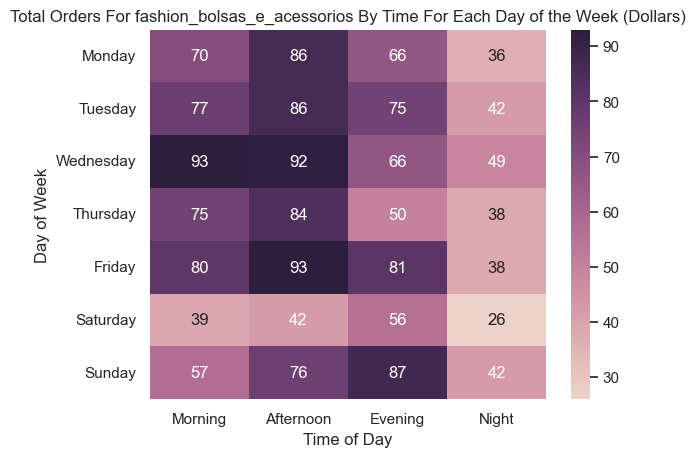

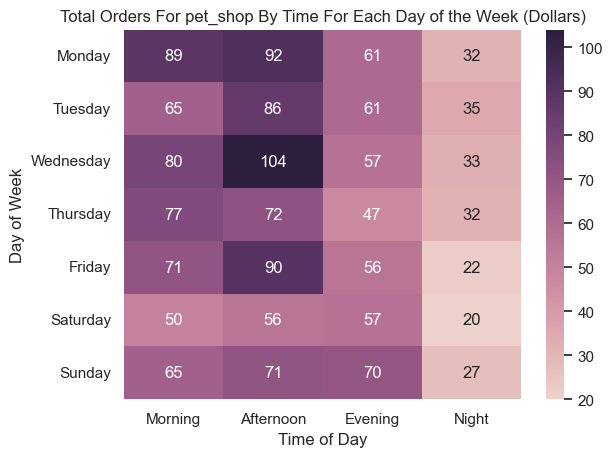

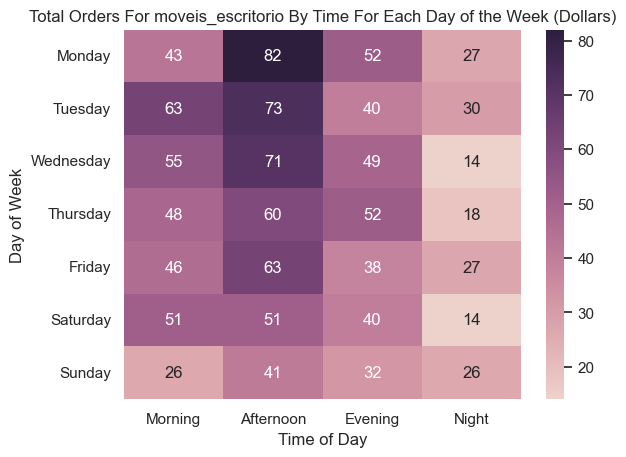

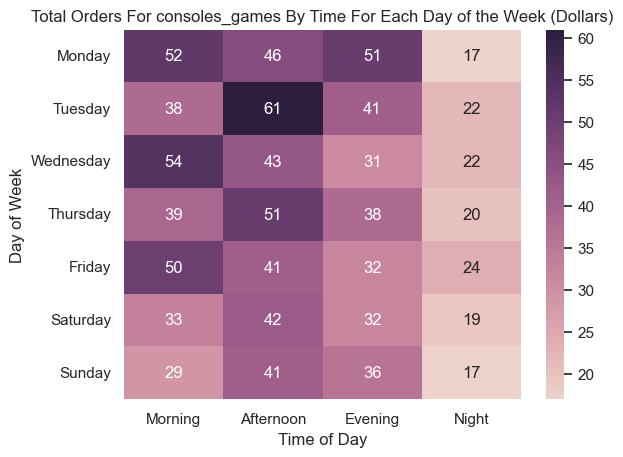

In [36]:
list_of_prod_cats = full_df.groupby('product_category_name').size().to_frame().reset_index().sort_values(0, ascending=False).iloc[0:20, :]['product_category_name'].to_numpy()

#list_of_prod_cats = list_of_prod_cats[0]

for i, prod_cat in enumerate(list_of_prod_cats):
    temp_df = full_df[full_df['product_category_name'] == prod_cat]
    pivot_prod_order = temp_df.pivot_table(values = ['order_id']
                              , index=['purchase_day','time_range', "product_category_name"]
                              , aggfunc={'order_id':'nunique'})

    pivot_prod_order = pivot_prod_order.reset_index().pivot("purchase_day", "time_range", "order_id")

    day_of_wk = ['Monday', 'Tuesday', 'Wednesday','Thursday','Friday','Saturday','Sunday']
    time_of_day = ['Morning', 'Afternoon', 'Evening', 'Night']
    pivot_prod_order = pivot_prod_order.reindex(day_of_wk, axis=0)
    pivot_prod_order = pivot_prod_order.reindex(time_of_day, axis=1)

    plt.figure(i)
    sns.heatmap(pivot_prod_order, annot=True, cmap=sns.cubehelix_palette(as_cmap=True), fmt='g')
    plt.title("Total Orders For " + prod_cat + " By Time For Each Day of the Week (Dollars)")
    plt.xlabel("Time of Day")
    plt.ylabel("Day of Week")
    
                          

In [37]:
list_of_prod_cats = full_df.groupby('product_category_name').size().to_frame().reset_index().sort_values(0, ascending=False).iloc[0:20, :]['product_category_name'].to_numpy()
list_of_prod_cats

array(['cama_mesa_banho', 'beleza_saude', 'esporte_lazer',
       'moveis_decoracao', 'informatica_acessorios',
       'utilidades_domesticas', 'relogios_presentes', 'telefonia',
       'ferramentas_jardim', 'automotivo', 'brinquedos', 'cool_stuff',
       'perfumaria', 'bebes', 'eletronicos', 'papelaria',
       'fashion_bolsas_e_acessorios', 'pet_shop', 'moveis_escritorio',
       'consoles_games'], dtype=object)

Text(47.24999999999999, 0.5, 'Day of Week')

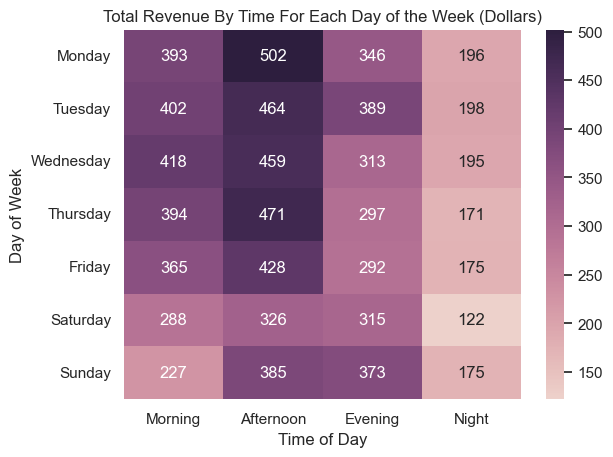

In [38]:
temp_df = full_df[full_df['product_category_name'] == "cama_mesa_banho"]
pivot_prod_order = temp_df.pivot_table(values = ['order_id']
                            , index=['purchase_day','time_range', "product_category_name"]
                            , aggfunc={'order_id':'nunique'})

pivot_prod_order = pivot_prod_order.reset_index().pivot("purchase_day", "time_range", "order_id")

day_of_wk = ['Monday', 'Tuesday', 'Wednesday','Thursday','Friday','Saturday','Sunday']
time_of_day = ['Morning', 'Afternoon', 'Evening', 'Night']
pivot_prod_order = pivot_prod_order.reindex(day_of_wk, axis=0)
pivot_prod_order = pivot_prod_order.reindex(time_of_day, axis=1)


sns.heatmap(pivot_prod_order, annot=True, cmap=sns.cubehelix_palette(as_cmap=True), fmt='g')
plt.title("Total Revenue By Time For Each Day of the Week (Dollars)")
plt.xlabel("Time of Day")
plt.ylabel("Day of Week")


In [39]:
temp_df = full_df[full_df['product_category_name'].isin(list_of_prod_cats[0:11])]

pivot_prod_order_line = temp_df.pivot_table(values = ['order_id']
                              , index=['purchase_year','purchase_month','purchase_MMYYYY', 'product_category_name']
                              , aggfunc={'order_id':'nunique'})
pivot_prod_order_line = pivot_prod_order_line.reset_index()
pivot_prod_order_line

,purchase_year,purchase_month,purchase_MMYYYY,product_category_name,order_id
0,2016,9,Sep-16,moveis_decoracao,1
1,2016,9,Sep-16,telefonia,1
2,2016,10,Oct-16,automotivo,11
3,2016,10,Oct-16,beleza_saude,42
4,2016,10,Oct-16,brinquedos,24
...,...,...,...,...,...
228,2018,8,Aug-18,informatica_acessorios,383
229,2018,8,Aug-18,moveis_decoracao,343
230,2018,8,Aug-18,relogios_presentes,392
231,2018,8,Aug-18,telefonia,244


Text(0, 0.5, 'Number of Orders')

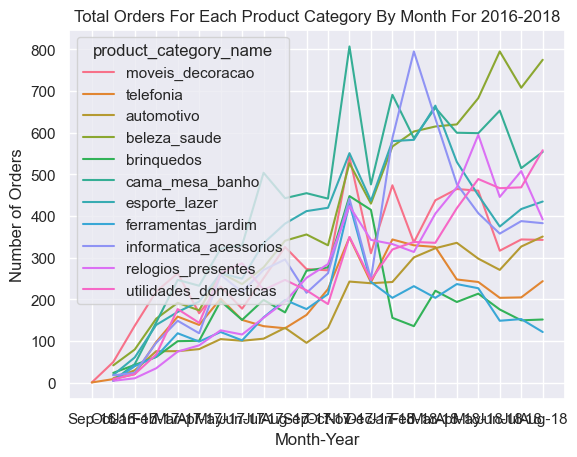

In [40]:
sns.lineplot(data=pivot_prod_order_line, x="purchase_MMYYYY", y="order_id", hue="product_category_name")
sns.set(rc={'figure.figsize':(20,10)})
plt.title("Total Orders For Each Product Category By Month For 2016-2018")
plt.xlabel("Month-Year")
plt.ylabel("Number of Orders")


In [41]:
temp_df = full_df[full_df['product_category_name'].isin(list_of_prod_cats[0:11])]

pivot_prod_revenue_line = temp_df.pivot_table(values = ['price']
                              , index=['purchase_year','purchase_month','purchase_MMYYYY', 'product_category_name']
                              , aggfunc={'price':'sum'})
pivot_prod_revenue_line = pivot_prod_revenue_line.reset_index()
pivot_prod_revenue_line

,purchase_year,purchase_month,purchase_MMYYYY,product_category_name,price
0,2016,9,Sep-16,moveis_decoracao,72.89
1,2016,9,Sep-16,telefonia,59.50
2,2016,10,Oct-16,automotivo,1833.25
3,2016,10,Oct-16,beleza_saude,4572.71
4,2016,10,Oct-16,brinquedos,3965.11
...,...,...,...,...,...
228,2018,8,Aug-18,informatica_acessorios,40989.30
229,2018,8,Aug-18,moveis_decoracao,44430.97
230,2018,8,Aug-18,relogios_presentes,76581.87
231,2018,8,Aug-18,telefonia,39334.93


Text(0, 0.5, 'Revenue ($)')

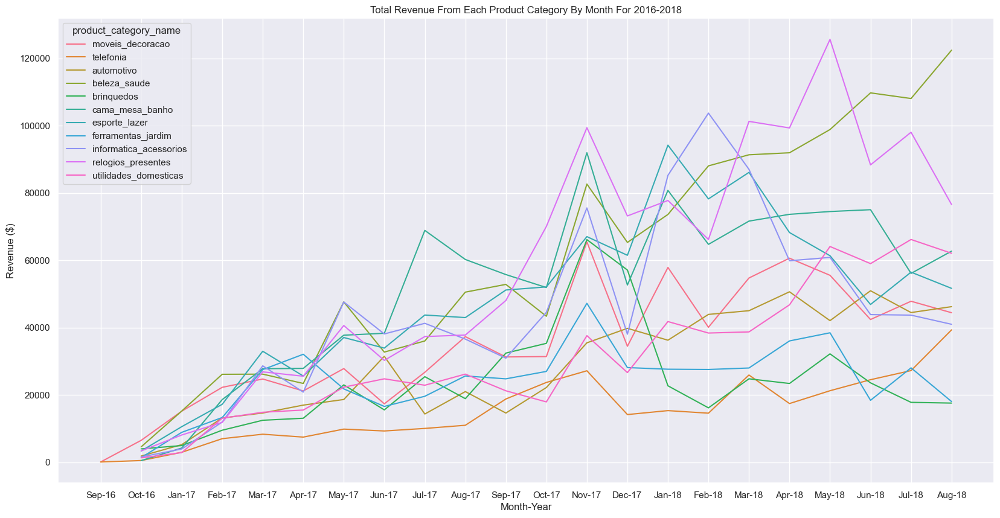

In [42]:
sns.lineplot(data=pivot_prod_revenue_line, x="purchase_MMYYYY", y="price", hue="product_category_name")
sns.set(rc={'figure.figsize':(20,10)})
plt.title("Total Revenue From Each Product Category By Month For 2016-2018")
plt.xlabel("Month-Year")
plt.ylabel("Revenue ($)")

In [43]:
list_of_prod_cats

array(['cama_mesa_banho', 'beleza_saude', 'esporte_lazer',
       'moveis_decoracao', 'informatica_acessorios',
       'utilidades_domesticas', 'relogios_presentes', 'telefonia',
       'ferramentas_jardim', 'automotivo', 'brinquedos', 'cool_stuff',
       'perfumaria', 'bebes', 'eletronicos', 'papelaria',
       'fashion_bolsas_e_acessorios', 'pet_shop', 'moveis_escritorio',
       'consoles_games'], dtype=object)

In [44]:
# Gets the first three and four first digits of zip codes, we will explore this further to understand how zip codes works
geolocation_df['geolocation_zip_code_prefix'] = geolocation_df['geolocation_zip_code_prefix'].map(str)
geolocation_df['geolocation_zip_code_prefix_1_digits'] = geolocation_df['geolocation_zip_code_prefix'].str[0:1]
geolocation_df['geolocation_zip_code_prefix_2_digits'] = geolocation_df['geolocation_zip_code_prefix'].str[0:2]
geolocation_df['geolocation_zip_code_prefix_3_digits'] = geolocation_df['geolocation_zip_code_prefix'].str[0:3]
geolocation_df['geolocation_zip_code_prefix_4_digits'] = geolocation_df['geolocation_zip_code_prefix'].str[0:4]

# Removing some outliers
#Brazils most Northern spot is at 5 deg 16′ 27.8″ N latitude.;
geolocation_df = geolocation_df[geolocation_df.geolocation_lat <= 5.27438888]
#it’s most Western spot is at 73 deg, 58′ 58.19″W Long.
geolocation_df = geolocation_df[geolocation_df.geolocation_lng >= -73.98283055]
#It’s most southern spot is at 33 deg, 45′ 04.21″ S Latitude.
geolocation_df = geolocation_df[geolocation_df.geolocation_lat >= -33.75116944]
#It’s most Eastern spot is 34 deg, 47′ 35.33″ W Long.
geolocation_df = geolocation_df[geolocation_df.geolocation_lng <=  -34.79314722]


geolocation_df['geolocation_zip_code_prefix'] = geolocation_df['geolocation_zip_code_prefix'].astype(int)
geolocation_df['geolocation_zip_code_prefix_1_digits'] = geolocation_df['geolocation_zip_code_prefix_1_digits'].astype(int)
geolocation_df['geolocation_zip_code_prefix_2_digits'] = geolocation_df['geolocation_zip_code_prefix_2_digits'].astype(int)
geolocation_df['geolocation_zip_code_prefix_3_digits'] = geolocation_df['geolocation_zip_code_prefix_3_digits'].astype(int)
geolocation_df['geolocation_zip_code_prefix_4_digits'] = geolocation_df['geolocation_zip_code_prefix_4_digits'].astype(int)

brazil = geolocation_df
agg_name = 'geolocation_zip_code_prefix'

In [45]:
from datashader.utils import lnglat_to_meters as webm
x, y = webm(geolocation_df.geolocation_lng, geolocation_df.geolocation_lat)
geolocation_df['x'] = pd.Series(x)
geolocation_df['y'] = pd.Series(y)

Loading BokehJS ...

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
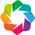

In [46]:
# plot wtih holoviews + datashader - bokeh with map background
import holoviews as hv
import geoviews as gv
import datashader as ds
from colorcet import fire, rainbow, bgy, bjy, bkr, kb, kr
from datashader.colors import colormap_select, Greys9
from holoviews.streams import RangeXY
from holoviews.operation.datashader import datashade, dynspread, rasterize
from bokeh.io import push_notebook, show, output_notebook
output_notebook()
hv.extension('bokeh')

%opts Overlay [width=800 height=600 toolbar='above' xaxis=None yaxis=None]
%opts QuadMesh [tools=['hover'] colorbar=True] (alpha=0 hover_alpha=0.2)

T = 0.05
PX = 1

def plot_map(data, label, agg_data, agg_name, cmap):
    url="http://server.arcgisonline.com/ArcGIS/rest/services/Canvas/World_Dark_Gray_Base/MapServer/tile/{Z}/{Y}/{X}.png"
    geomap = gv.WMTS(url)
    points = hv.Points(gv.Dataset(data, kdims=['x', 'y'], vdims=[agg_name]))
    print(points)
    agg = datashade(points, element_type=gv.Image, aggregator=agg_data, cmap=cmap)
    zip_codes = dynspread(agg, threshold=T, max_px=PX)
    hover = hv.util.Dynamic(rasterize(points, aggregator=agg_data, width=50, height=25, streams=[RangeXY]), operation=hv.QuadMesh)
    hover = hover.options(cmap=cmap)
    img = geomap * zip_codes * hover
    img = img.relabel(label)
    return img

In [47]:
plot_map(brazil, 'Zip Codes in Brazil', ds.min(agg_name), agg_name, cmap=rainbow)


:Points   [x,y]   (geolocation_zip_code_prefix)


:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y geolocation_zip_code_prefix)

In [48]:
# plot wtih datashader - image with black background
import datashader as ds
from datashader import transfer_functions as tf
from functools import partial
from datashader.utils import export_image
from IPython.core.display import HTML, display
from colorcet import fire, rainbow, bgy, bjy, bkr, kb, kr

background = "black"
cm = partial(colormap_select, reverse=(background!="black"))
export = partial(export_image, background = background, export_path="export")
display(HTML("<style>.container { width:100% !important; }</style>"))
W = 700 

def create_map(data, cmap, data_agg, export_name='img'):
    pad = (data.x.max() - data.x.min())/50
    x_range, y_range = ((data.x.min() - pad, data.x.max() + pad), 
                             (data.y.min() - pad, data.y.max() + pad))

    ratio = (y_range[1] - y_range[0]) / (x_range[1] - x_range[0])

    plot_width  = int(W)
    plot_height = int(plot_width * ratio)
    if ratio > 1.5:
        plot_height = 550
        plot_width = int(plot_height / ratio)
        
    cvs = ds.Canvas(plot_width=plot_width, plot_height=plot_height, x_range=x_range, y_range=y_range)

    agg = cvs.points(data, 'x', 'y', data_agg)
    img = tf.shade(agg, cmap=cmap, how='eq_hist')
    return export(img, export_name)

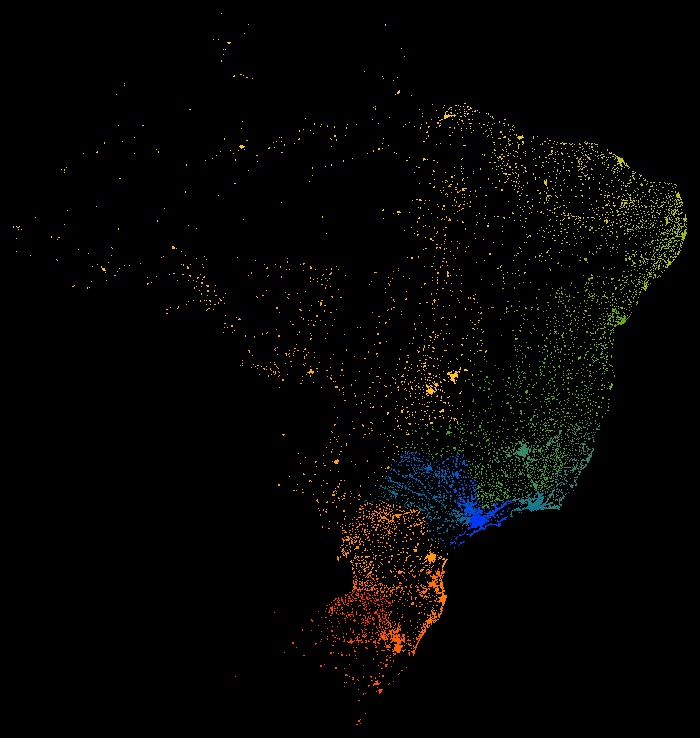

In [49]:
create_map(brazil, rainbow, ds.mean(agg_name),'brazil_zip_codes')


In [50]:
def filter_data(level, name):
    df = geolocation_df[geolocation_df[level] == name]
    #remove outliers
    df = df[(df.x <= df.x.quantile(0.999)) & (df.x >= df.x.quantile(0.001))]
    df = df[(df.y <= df.y.quantile(0.999)) & (df.y >= df.y.quantile(0.001))]
    return df
sp = filter_data('geolocation_state', 'SP')
agg_name = 'geolocation_zip_code_prefix'
sp[agg_name].describe().to_frame()
plot_map(sp, 'Zip Codes in Sao Paulo State', ds.min(agg_name), agg_name, cmap=rainbow)



:Points   [x,y]   (geolocation_zip_code_prefix)


:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y geolocation_zip_code_prefix)

In [51]:
saopaulo = filter_data('geolocation_city', 'sao paulo')
agg_name = 'geolocation_zip_code_prefix'
saopaulo[agg_name].describe().to_frame()
plot_map(saopaulo, 'Zip Codes in Sao Paulo City', ds.min(agg_name), agg_name, cmap=rainbow)


:Points   [x,y]   (geolocation_zip_code_prefix)


:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y geolocation_zip_code_prefix)

In [52]:
# getting the first 3 digits of customers_df zipcode
customers_df['customer_zip_code_prefix'] = customers_df['customer_zip_code_prefix'].map(str)
customers_df['customer_zip_code_prefix_3_digits'] = customers_df['customer_zip_code_prefix'].str[1:6]
customers_df['customer_zip_code_prefix_3_digits'] = customers_df['customer_zip_code_prefix_3_digits'].astype(int)

brazil_geo = geolocation_df.set_index('geolocation_zip_code_prefix_3_digits').copy()


In [53]:
# merging the data
orders = orders_df.merge(order_items_df, on='order_id')
orders = orders.merge(customers_df, on='customer_id')
orders = orders.merge(order_reviews_df, on='order_id')
orders = orders.merge(products_df, on='product_id')
orders = orders[orders['product_category_name'] == 'beleza_saude']
orders['count_'] = 1

gp = orders.groupby('customer_zip_code_prefix_3_digits')['count_'].sum().to_frame()
gp["count_"] = 1
revenue = brazil_geo.join(gp)
agg_name = 'revenue'
revenue[agg_name] = revenue.count_

In [54]:
# merging the data
orders = orders_df.merge(order_items_df, on='order_id')
orders = orders.merge(customers_df, on='customer_id')
orders = orders.merge(order_reviews_df, on='order_id')
orders = orders.merge(products_df, on='product_id')
orders = orders[orders['product_category_name'] == 'automotivo']
orders['count_'] = 1

gp = orders.groupby('customer_zip_code_prefix_3_digits')['count_'].sum().to_frame()
gp["count_"] = 1
revenue_1 = brazil_geo.join(gp)
agg_name = 'revenue'
revenue_1[agg_name] = revenue_1.count_

In [55]:
plot_map(revenue, 'Orders Revenue', ds.mean(agg_name), agg_name, cmap=Greys9)
plot_map(revenue_1, 'Orders Revenue', ds.mean(agg_name), agg_name, cmap=rainbow)
plot_map(revenue, 'Orders Revenue', ds.mean(agg_name), agg_name, cmap=Greys9)



:Points   [x,y]   (revenue)
:Points   [x,y]   (revenue)
:Points   [x,y]   (revenue)


:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (x_y revenue)

# PCA

In [56]:
# interesting_cats = ['bebes', 'moveis_escritorio', 'perfumaria']
# interesting_states = full_df.seller_state.value_counts().to_frame().reset_index()['index'][1:6].to_numpy()

# 0:15, 0:10 (MOST SIMPLE), 0:20 (BEST?)
interesting_sellers = full_df['seller_id'].value_counts().to_frame().reset_index()['index'][0:10].to_numpy()

#filtered_df_top_five = full_df
filtered_df_top_five = full_df[full_df['seller_id'].isin(interesting_sellers)]
# filtered_df_top_five = full_df[full_df['product_category_name'].isin(interesting_cats)]
filtered_df_top_five['seller_id'].value_counts()

4a3ca9315b744ce9f8e9374361493884    2128
6560211a19b47992c3666cc44a7e94c0    2111
1f50f920176fa81dab994f9023523100    2009
cc419e0650a3c5ba77189a1882b7556a    1885
da8622b14eb17ae2831f4ac5b9dab84a    1656
955fee9216a65b617aa5c0531780ce60    1517
1025f0e2d44d7041d6cf58b6550e0bfa    1465
7c67e1448b00f6e969d365cea6b010ab    1454
7a67c85e85bb2ce8582c35f2203ad736    1236
ea8482cd71df3c1969d7b9473ff13abc    1233
Name: seller_id, dtype: int64

In [57]:
len(filtered_df_top_five['seller_id'].unique())

10

In [58]:
# Get the unique seller_ids
unique_seller_ids = filtered_df_top_five['seller_id'].unique()

# Define a list of company names
company_names = ["Murazik - Lakin", "Prosacco, Crona and Haag", "Spinka - Smith", "Conn, Wisoky and Lynch",
              "Stracke, Langworth and Rath", "Yost - Rowe", "Strosin LLC", "Marquardt, Wolf and Graham",
              "Stiedemann LLC", "Stark and Sons", "Wiegand, Rodriguez and Botsford", "Bradtke - Kulas",
              "Kshlerin, MacGyver and Auer", "Kohler, Cassin and Mertz", "Weimann Group", "Wiza Group",
              "Becker Inc", "Klocko - Lesch", "Mraz and Sons", "Tremblay - Schmeler"]

# Create a dictionary to map seller_ids to company names
seller_id_to_company_name = {}

# Iterate over the unique seller_ids
for company_name, seller_id in zip(company_names, unique_seller_ids):
  
    # Add the seller_id and company name to the dictionary
    seller_id_to_company_name[seller_id] = company_name
    # Replace the seller_id in the dataframe with the company name
    filtered_df_top_five.loc[filtered_df_top_five['seller_id'] == seller_id, 'seller_id'] = company_name

In [59]:
filtered_df_top_five['product_category_name']

3102     moveis_escritorio
3103     moveis_escritorio
3104     moveis_escritorio
3105     moveis_escritorio
3106     moveis_escritorio
               ...        
54588           cool_stuff
54589           cool_stuff
54590           cool_stuff
54591                bebes
54592                bebes
Name: product_category_name, Length: 16694, dtype: object

In [60]:
# features = ['payment_sequential', 'payment_installments', 'payment_value', 'customer_zip_code_prefix', 
# 'order_item_id', 'price', 'freight_value', 'product_name_lenght', 'product_description_lenght', 'product_photos_qty', 'product_weight_g', 'product_length_cm',
#        'product_height_cm', 'product_width_cm', 'seller_zip_code_prefix', 'purchase_hour', 'elapsed_deliv_estim_days', 'seller_id']

features = ['payment_sequential', 'payment_installments', 'payment_value','price', 'freight_value', 'product_name_lenght', 'product_description_lenght', 'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'purchase_hour', 'elapsed_deliv_estim_days', 'review_score', 'product_category_name', 'seller_id']


filtered_df_top_five = filtered_df_top_five[features]

In [61]:
# List of columns to convert to float
cols_to_convert = features[0:-3]

# Convert columns to float
filtered_df_top_five[cols_to_convert] = filtered_df_top_five[cols_to_convert].astype(float)

filtered_df_top_five = filtered_df_top_five.dropna()

filtered_df_top_five['seller_id'] = filtered_df_top_five['seller_id'].astype(str)
filtered_df_top_five['product_category_name'] = filtered_df_top_five['product_category_name'].astype(str)


filtered_df_top_five.dtypes

payment_sequential            float64
payment_installments          float64
payment_value                 float64
price                         float64
freight_value                 float64
product_name_lenght           float64
product_description_lenght    float64
product_photos_qty            float64
product_weight_g              float64
product_length_cm             float64
product_height_cm             float64
product_width_cm              float64
purchase_hour                 float64
elapsed_deliv_estim_days      float64
review_score                    int64
product_category_name          object
seller_id                      object
dtype: object

In [62]:
from sklearn.preprocessing import StandardScaler

y = filtered_df_top_five['seller_id'].to_frame()

t = filtered_df_top_five[features[0:-3]]
x = StandardScaler().fit_transform(t)

In [63]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents, columns = ['principal component 1', 'principal component 2'])

In [64]:
finalDf = pd.concat([principalDf, y], axis = 1)
finalDf = pd.concat([finalDf, filtered_df_top_five[['product_category_name']]], axis = 1)
finalDf = pd.concat([finalDf, filtered_df_top_five[['review_score']]], axis = 1)
finalDf = finalDf.dropna()
print(finalDf['seller_id'].unique())
finalDf

['Murazik - Lakin' 'Prosacco, Crona and Haag' 'Spinka - Smith'
 'Conn, Wisoky and Lynch']


,principal component 1,principal component 2,seller_id,product_category_name,review_score
3102,-1.579028,0.771230,Murazik - Lakin,moveis_escritorio,5.0
3103,-1.292388,0.670118,Murazik - Lakin,moveis_escritorio,5.0
3104,-1.382098,0.901258,Murazik - Lakin,moveis_escritorio,1.0
3105,-1.477790,0.782857,Murazik - Lakin,moveis_escritorio,3.0
3106,-1.542141,0.660279,Murazik - Lakin,moveis_escritorio,2.0
...,...,...,...,...,...
15825,0.916787,1.259748,"Conn, Wisoky and Lynch",ferramentas_jardim,5.0
15826,1.012299,1.048768,"Conn, Wisoky and Lynch",instrumentos_musicais,3.0
15827,0.924235,1.229082,"Conn, Wisoky and Lynch",esporte_lazer,3.0
15828,0.781354,1.258019,"Conn, Wisoky and Lynch",automotivo,5.0


(-3.0, 3.0)

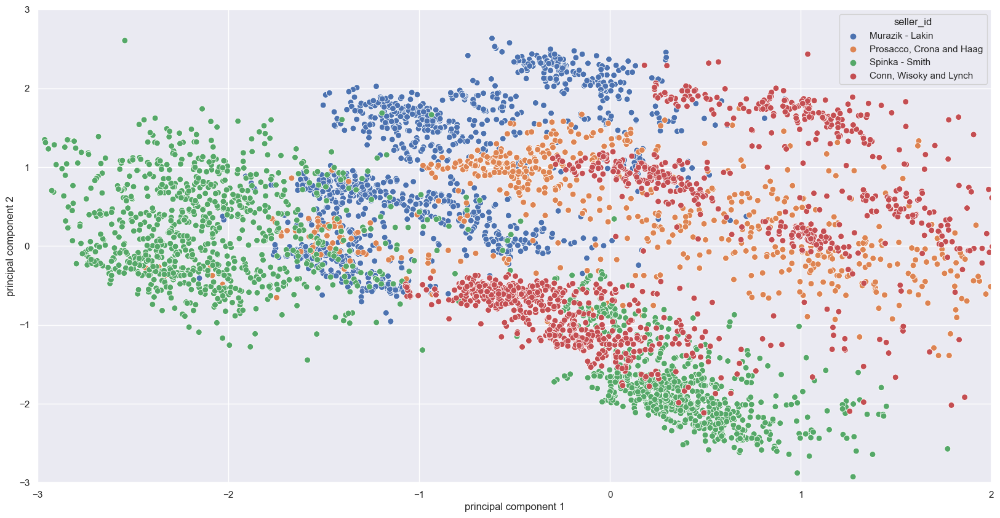

In [65]:
sns.scatterplot(data=finalDf, x='principal component 1', y='principal component 2', hue='seller_id', s=50) #s=10

#0:20
# plt.xlim(-3, 5)
# plt.ylim(-4.5, 4)

# 0:15, 0:10
plt.xlim(-3, 2)
plt.ylim(-3, 3)

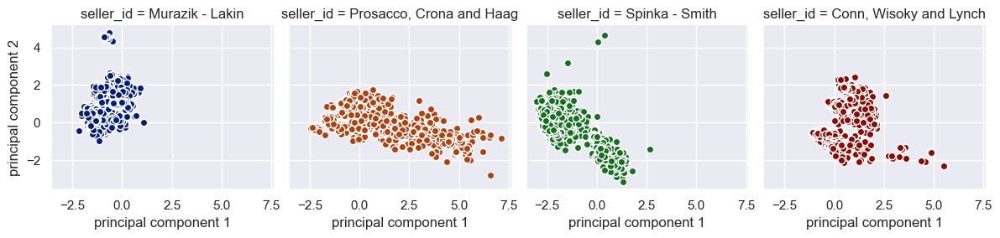

In [66]:
# Use seaborn for easy faceting
g = sns.FacetGrid(finalDf, col='seller_id', hue='seller_id', col_wrap=4, palette='dark')
g = (g.map(plt.scatter, "principal component 1", "principal component 2", edgecolor="w"))

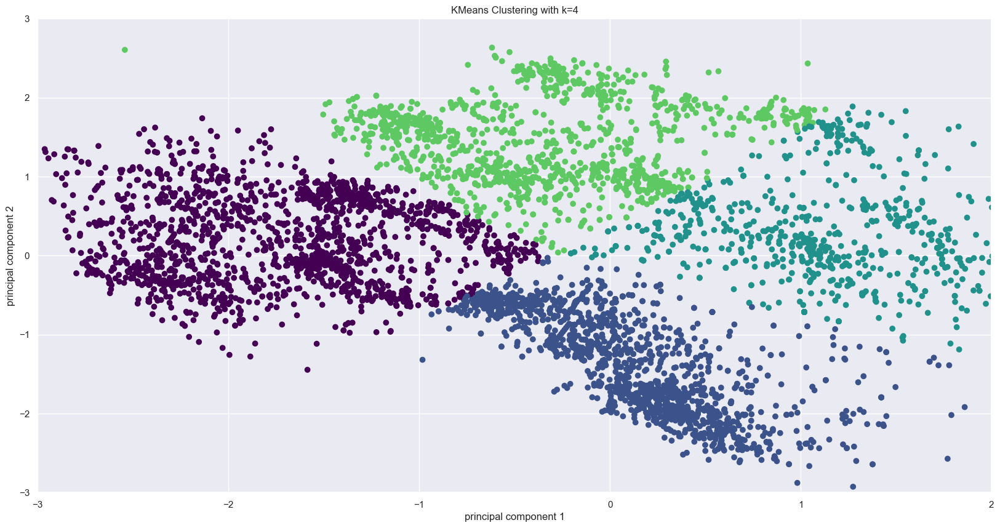

In [67]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Create a KMeans model with k=4
kmeans = KMeans(n_clusters=5)

# Fit the model to the 'principal component 1' and 'principal component 2' columns
finalDf = finalDf.dropna()
kmeans.fit(finalDf[['principal component 1', 'principal component 2']])

# Predict the cluster labels for each data point
labels = kmeans.predict(finalDf[['principal component 1', 'principal component 2']])

# finalDf = pd.concat([finalDf, pd.DataFrame(labels)], axis=1)

# finalDf = finalDf.rename({0: "labels"}, axis=1)



# Plot the scatter plot
plt.scatter(finalDf['principal component 1'], finalDf['principal component 2'], c=labels, cmap='viridis')
plt.xlim(-3, 2)
plt.ylim(-3, 3)
plt.xlabel('principal component 1')
plt.ylabel('principal component 2')
plt.title('KMeans Clustering with k=4')
plt.show()


# sns.scatterplot(data=finalDf, x='principal component 1', y='principal component 2', hue='labels', s=20) #s=10

# #0:20
# plt.xlim(-3, 5)
# plt.ylim(-4.5, 4)

# # 0:15, 0:10

# # # Plot the scatter plot
# # plt.scatter(finalDf['principal component 1'], finalDf['principal component 2'], c=labels)
# # plt.xlabel('principal component 1')
# # plt.ylabel('principal component 2')
# # plt.title('KMeans Clustering with k=4')
# # plt.show()

In [68]:
finalDf

,principal component 1,principal component 2,seller_id,product_category_name,review_score
3102,-1.579028,0.771230,Murazik - Lakin,moveis_escritorio,5.0
3103,-1.292388,0.670118,Murazik - Lakin,moveis_escritorio,5.0
3104,-1.382098,0.901258,Murazik - Lakin,moveis_escritorio,1.0
3105,-1.477790,0.782857,Murazik - Lakin,moveis_escritorio,3.0
3106,-1.542141,0.660279,Murazik - Lakin,moveis_escritorio,2.0
...,...,...,...,...,...
15825,0.916787,1.259748,"Conn, Wisoky and Lynch",ferramentas_jardim,5.0
15826,1.012299,1.048768,"Conn, Wisoky and Lynch",instrumentos_musicais,3.0
15827,0.924235,1.229082,"Conn, Wisoky and Lynch",esporte_lazer,3.0
15828,0.781354,1.258019,"Conn, Wisoky and Lynch",automotivo,5.0


In [69]:
finalDf

,principal component 1,principal component 2,seller_id,product_category_name,review_score
3102,-1.579028,0.771230,Murazik - Lakin,moveis_escritorio,5.0
3103,-1.292388,0.670118,Murazik - Lakin,moveis_escritorio,5.0
3104,-1.382098,0.901258,Murazik - Lakin,moveis_escritorio,1.0
3105,-1.477790,0.782857,Murazik - Lakin,moveis_escritorio,3.0
3106,-1.542141,0.660279,Murazik - Lakin,moveis_escritorio,2.0
...,...,...,...,...,...
15825,0.916787,1.259748,"Conn, Wisoky and Lynch",ferramentas_jardim,5.0
15826,1.012299,1.048768,"Conn, Wisoky and Lynch",instrumentos_musicais,3.0
15827,0.924235,1.229082,"Conn, Wisoky and Lynch",esporte_lazer,3.0
15828,0.781354,1.258019,"Conn, Wisoky and Lynch",automotivo,5.0


In [70]:
# 0:15, 0:10 (MOST SIMPLE), 0:20 (BEST?)
top_4_products = finalDf['product_category_name'].value_counts().to_frame().reset_index()['index'][0:4].to_numpy()

#filtered_df_top_five = full_df
top_4_products_df = finalDf[finalDf['product_category_name'].isin(top_4_products)]
top_4_products_df

,principal component 1,principal component 2,seller_id,product_category_name,review_score
3102,-1.579028,0.771230,Murazik - Lakin,moveis_escritorio,5.0
3103,-1.292388,0.670118,Murazik - Lakin,moveis_escritorio,5.0
3104,-1.382098,0.901258,Murazik - Lakin,moveis_escritorio,1.0
3105,-1.477790,0.782857,Murazik - Lakin,moveis_escritorio,3.0
3106,-1.542141,0.660279,Murazik - Lakin,moveis_escritorio,2.0
...,...,...,...,...,...
15783,1.552627,0.627872,"Conn, Wisoky and Lynch",beleza_saude,5.0
15784,1.878824,-0.059952,"Conn, Wisoky and Lynch",beleza_saude,5.0
15796,1.524186,0.465889,"Conn, Wisoky and Lynch",moveis_escritorio,5.0
15797,1.675050,0.420040,"Conn, Wisoky and Lynch",moveis_escritorio,4.0


(-3.0, 3.0)

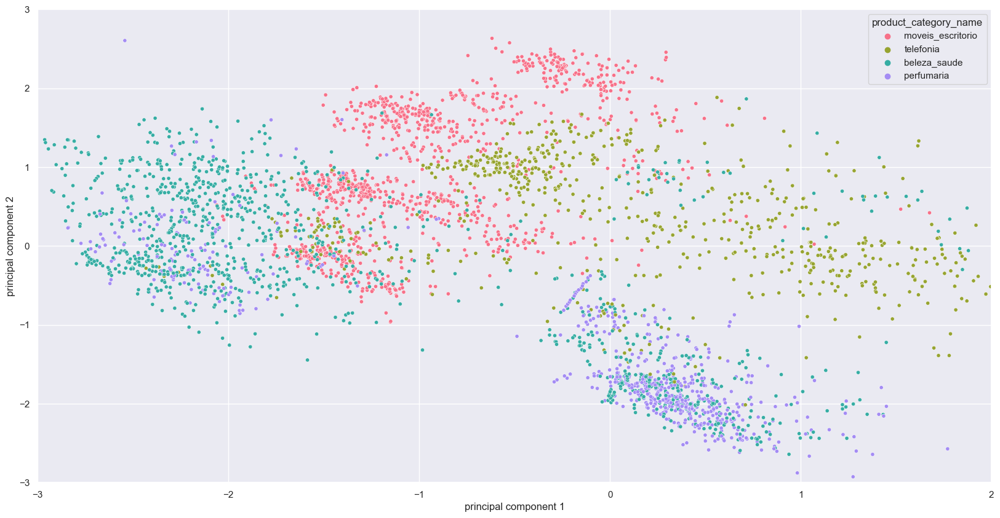

In [71]:
#full_df['customer_id'].value_counts().to_frame().reset_index()['index'][0:6].to_numpy()
sns.scatterplot(data=top_4_products_df, x='principal component 1', y='principal component 2', hue='product_category_name', s=20, palette='husl') #s=10

plt.xlim(-3, 2)
plt.ylim(-3, 3)


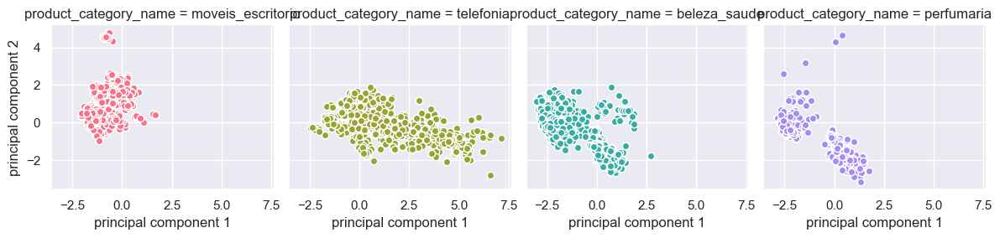

In [72]:
# Use seaborn for easy faceting
g = sns.FacetGrid(top_4_products_df, col='product_category_name', hue='product_category_name', col_wrap=4, palette='husl')
g = (g.map(plt.scatter, "principal component 1", "principal component 2", edgecolor="w"))

(-3.0, 3.0)

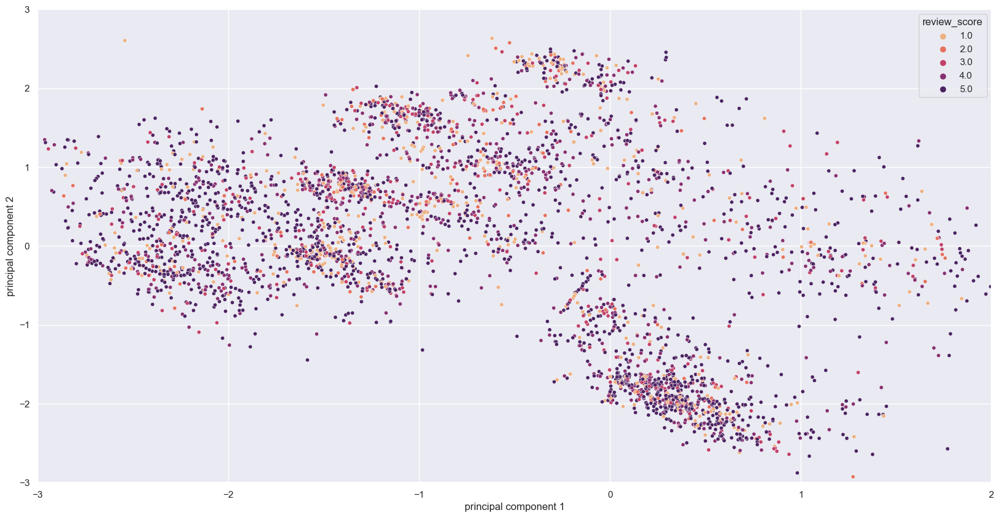

In [73]:
sns.scatterplot(data=top_4_products_df, x='principal component 1', y='principal component 2', hue='review_score', s=20, palette='flare') #s=10

plt.xlim(-3, 2)
plt.ylim(-3, 3)

In [74]:
full_df.seller_state.value_counts().to_frame().reset_index()['index'][0:6].to_numpy()

array(['SP', 'MG', 'PR', 'RJ', 'SC', 'RS'], dtype=object)

In [75]:
import plotly.express as px

pca = PCA(n_components=3)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents, columns = ['principal component 1', 'principal component 2', 'principal component 3'])

finalDf = pd.concat([principalDf, y], axis = 1)
finalDf = pd.concat([finalDf, filtered_df_top_five[['product_category_name']]], axis = 1)
finalDf = pd.concat([finalDf, filtered_df_top_five[['review_score']]], axis = 1)
finalDf = finalDf.dropna()
print(finalDf['seller_id'].unique())

total_var = pca.explained_variance_ratio_.sum() * 100


fig = px.scatter_3d(
    finalDf, x='principal component 1', y='principal component 2', z='principal component 3', color=finalDf['review_score'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

['Murazik - Lakin' 'Prosacco, Crona and Haag' 'Spinka - Smith'
 'Conn, Wisoky and Lynch']


['Murazik - Lakin' 'Prosacco, Crona and Haag' 'Spinka - Smith'
 'Conn, Wisoky and Lynch' 'Stracke, Langworth and Rath' 'Yost - Rowe'
 'Strosin LLC' 'Marquardt, Wolf and Graham' 'Stiedemann LLC'
 'Stark and Sons' 'Wiegand, Rodriguez and Botsford' 'Bradtke - Kulas'
 'Kshlerin, MacGyver and Auer']


(-3.0, 3.0)

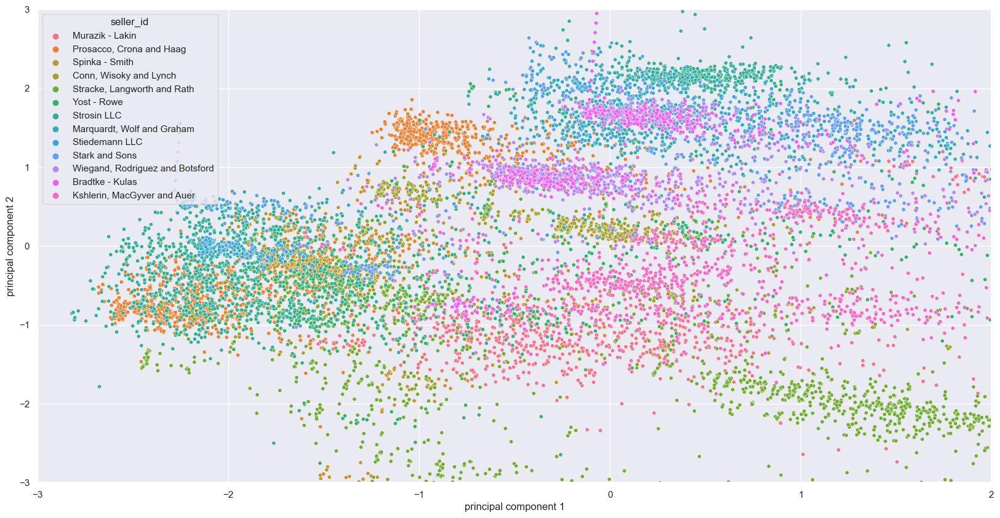

In [76]:
# 0:15, 0:10 (MOST SIMPLE), 0:20 (BEST?)
interesting_sellers = full_df['seller_id'].value_counts().to_frame().reset_index()['index'][0:20].to_numpy()

#filtered_df_top_five = full_df
filtered_df_top_five = full_df[full_df['seller_id'].isin(interesting_sellers)]
# filtered_df_top_five = full_df[full_df['product_category_name'].isin(interesting_cats)]
filtered_df_top_five['seller_id'].value_counts()

# Get the unique seller_ids
unique_seller_ids = filtered_df_top_five['seller_id'].unique()

# Define a list of company names
company_names = ["Murazik - Lakin", "Prosacco, Crona and Haag", "Spinka - Smith", "Conn, Wisoky and Lynch",
              "Stracke, Langworth and Rath", "Yost - Rowe", "Strosin LLC", "Marquardt, Wolf and Graham",
              "Stiedemann LLC", "Stark and Sons", "Wiegand, Rodriguez and Botsford", "Bradtke - Kulas",
              "Kshlerin, MacGyver and Auer", "Kohler, Cassin and Mertz", "Weimann Group", "Wiza Group",
              "Becker Inc", "Klocko - Lesch", "Mraz and Sons", "Tremblay - Schmeler"]

# Create a dictionary to map seller_ids to company names
seller_id_to_company_name = {}

# Iterate over the unique seller_ids
for company_name, seller_id in zip(company_names, unique_seller_ids):
  
    # Add the seller_id and company name to the dictionary
    seller_id_to_company_name[seller_id] = company_name
    # Replace the seller_id in the dataframe with the company name
    filtered_df_top_five.loc[filtered_df_top_five['seller_id'] == seller_id, 'seller_id'] = company_name


features = ['payment_sequential', 'payment_installments', 'payment_value','price', 'freight_value', 'product_name_lenght', 'product_description_lenght', 'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'purchase_hour', 'elapsed_deliv_estim_days', 'review_score', 'product_category_name', 'seller_id']


filtered_df_top_five = filtered_df_top_five[features]

# List of columns to convert to float
cols_to_convert = features[0:-3]

# Convert columns to float
filtered_df_top_five[cols_to_convert] = filtered_df_top_five[cols_to_convert].astype(float)

filtered_df_top_five = filtered_df_top_five.dropna()

filtered_df_top_five['seller_id'] = filtered_df_top_five['seller_id'].astype(str)
filtered_df_top_five['product_category_name'] = filtered_df_top_five['product_category_name'].astype(str)

from sklearn.preprocessing import StandardScaler

y = filtered_df_top_five['seller_id'].to_frame()

t = filtered_df_top_five[features[0:-3]]
x = StandardScaler().fit_transform(t)

from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents, columns = ['principal component 1', 'principal component 2'])

finalDf = pd.concat([principalDf, y], axis = 1)
finalDf = pd.concat([finalDf, filtered_df_top_five[['product_category_name']]], axis = 1)
finalDf = pd.concat([finalDf, filtered_df_top_five[['review_score']]], axis = 1)
finalDf = finalDf.dropna()
print(finalDf['seller_id'].unique())

sns.scatterplot(data=finalDf, x='principal component 1', y='principal component 2', hue='seller_id', s=20) #s=10

#0:20
plt.xlim(-3, 2)
plt.ylim(-3, 3)


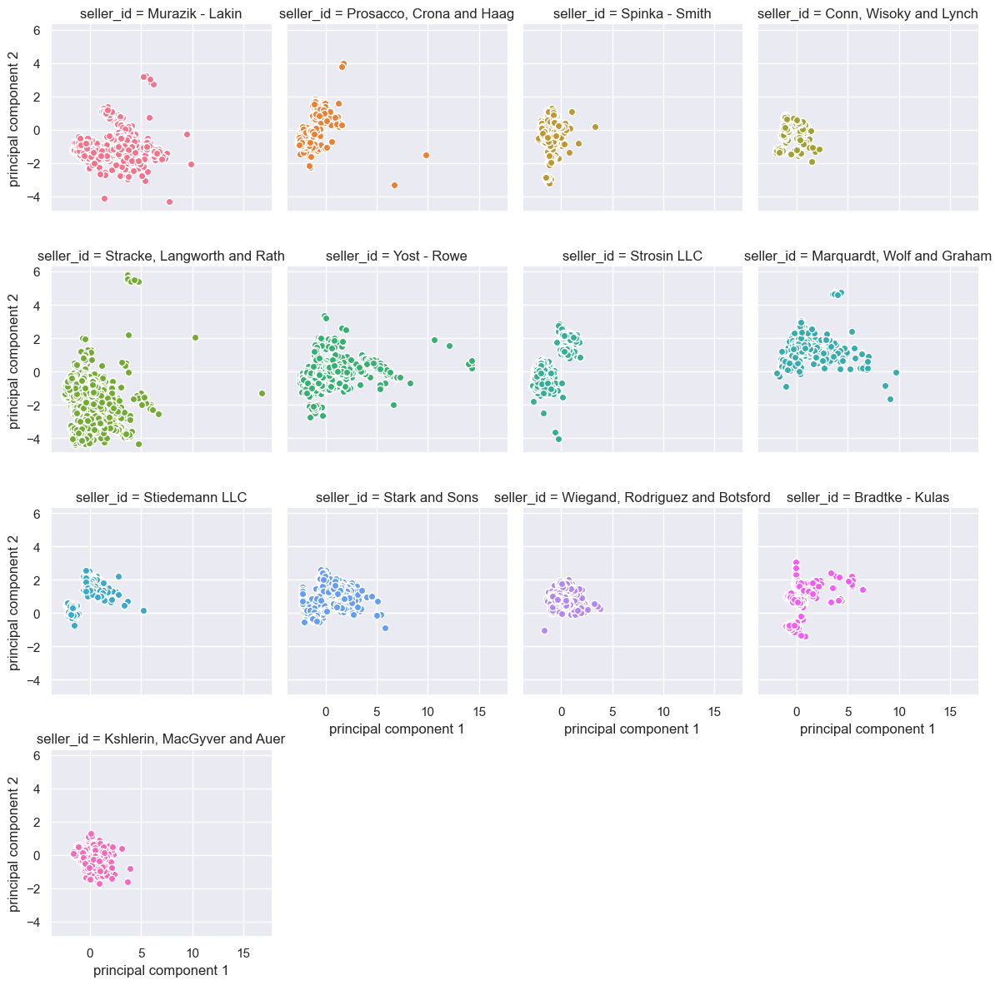

In [77]:
# Use seaborn for easy faceting
g = sns.FacetGrid(finalDf, col='seller_id', hue='seller_id', col_wrap=4)
g = (g.map(plt.scatter, "principal component 1", "principal component 2", edgecolor="w"))

(-3.0, 3.0)

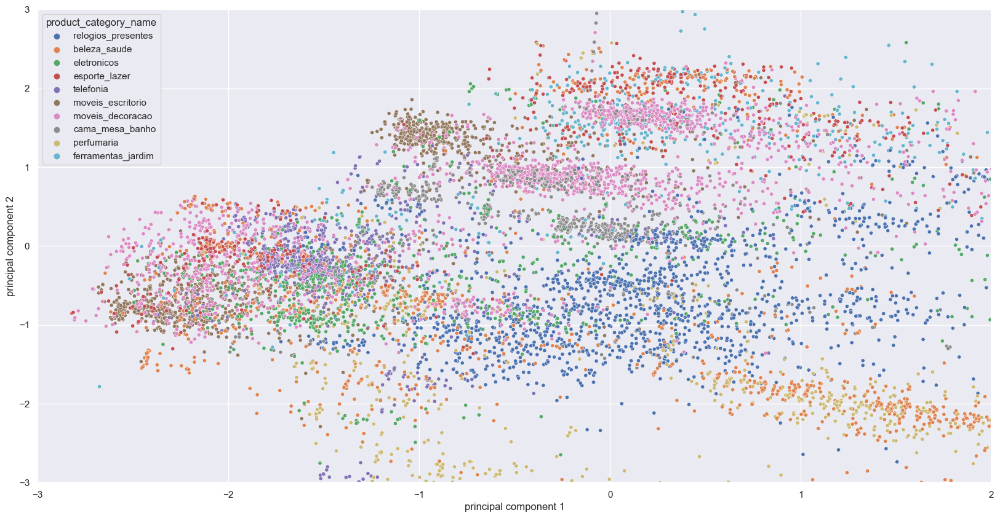

In [78]:
# 0:15, 0:10 (MOST SIMPLE), 0:20 (BEST?)
top_4_products = finalDf['product_category_name'].value_counts().to_frame().reset_index()['index'][0:10].to_numpy()

#filtered_df_top_five = full_df
top_4_products_df = finalDf[finalDf['product_category_name'].isin(top_4_products)]
sns.scatterplot(data=top_4_products_df, x='principal component 1', y='principal component 2', hue='product_category_name', s=20) #s=10
#0:20
plt.xlim(-3, 2)
plt.ylim(-3, 3)

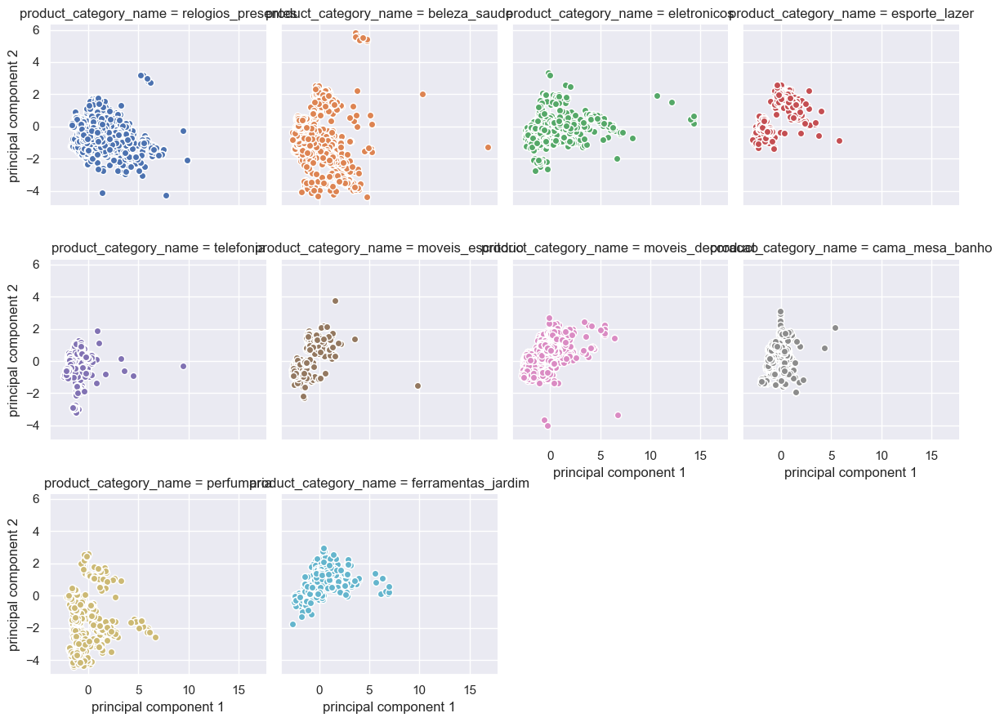

In [79]:
# Use seaborn for easy faceting
g = sns.FacetGrid(top_4_products_df, col='product_category_name', hue='product_category_name', col_wrap=4)
g = (g.map(plt.scatter, "principal component 1", "principal component 2", edgecolor="w"))

# Machine Learning

In [238]:
# SPECIFY THE NUMBER OF PRODUCT CATEGORIES FOR THE MODEL TO CLASSIFY: 
num_of_prod_cats = 6

#full_df = full_df.dropna()

top_products = full_df['product_category_name'].value_counts().to_frame().reset_index()['index'][0:num_of_prod_cats].to_numpy()

top_products_df = full_df[full_df['product_category_name'].isin(top_products)]


features = ['customer_state', 'order_status', 'review_score', 'payment_sequential', 'payment_installments', 'payment_value','price', 'freight_value', 'product_name_lenght', 'product_description_lenght', 'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'purchase_hour', 'elapsed_deliv_estim_days', 'purchase_year', 'purchase_month', 'purchase_MMYYYY', 'purchase_day', 'purchase_hour',
'elapsed_deliv_estim_days', 'order_purchase_timestamp_hour', 'product_category_name']

float_int_feats = ['payment_sequential', 'payment_installments', 'payment_value','price', 'freight_value', 'product_name_lenght', 'product_description_lenght', 'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'purchase_hour', 'elapsed_deliv_estim_days', 'elapsed_deliv_estim_days', 'order_purchase_timestamp_hour']


selected_features_y_raw = top_products_df[features]

selected_features_y_raw = selected_features_y_raw.dropna()

import random

# Define the number of rows to sample for each category
X = full_df['product_category_name'].value_counts().to_frame().reset_index()['product_category_name'][num_of_prod_cats]

# Get a list of unique categories
categories = selected_features_y_raw['product_category_name'].unique().tolist()

# Create an empty list to store the sampled dataframes
sampled_dataframes = []

# Loop over each category
for category in categories:
    # Get the data for the current category
    category_data = selected_features_y_raw[selected_features_y_raw['product_category_name'] == category]
    
    # Randomly sample X rows from the category data
    sampled_rows = category_data.sample(n=X, random_state=24)
    
    
    # Add the sampled data for the current category to the list
    sampled_dataframes.append(sampled_rows)

# Concatenate the sampled dataframes into a single dataframe
sampled_data = pd.concat(sampled_dataframes)


# List of columns to convert to float
cols_to_convert = float_int_feats[0:-3]

# Convert columns to float
sampled_data[cols_to_convert] = sampled_data[cols_to_convert].astype(float)

#sampled_data = sampled_data.dropna()

sampled_data['product_category_name'] = sampled_data['product_category_name'].astype(str)

In [239]:
y = sampled_data['product_category_name']

x = sampled_data.drop(columns=['product_category_name'])

# Get a list of object type columns
obj_cols = x.select_dtypes(include=['object']).columns

# One-hot encode the object type columns
x = pd.get_dummies(x, columns=obj_cols, prefix=obj_cols, prefix_sep='_', drop_first=True)
x = pd.get_dummies(x, columns=['review_score'], prefix='review_score', prefix_sep='_', drop_first=True)


x

,payment_sequential,payment_installments,payment_value,price,freight_value,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,...,purchase_day_Monday,purchase_day_Saturday,purchase_day_Sunday,purchase_day_Thursday,purchase_day_Tuesday,purchase_day_Wednesday,review_score_2,review_score_3,review_score_4,review_score_5
80313,1.0,6.0,66.44,49.90,16.54,60.0,185.0,2.0,525.0,25.0,...,0,1,0,0,0,0,0,0,0,1
94079,1.0,3.0,85.37,70.00,15.37,11.0,335.0,1.0,1000.0,31.0,...,0,0,0,1,0,0,0,0,0,0
59388,1.0,6.0,65.18,14.22,0.02,42.0,963.0,1.0,750.0,16.0,...,0,0,0,0,0,0,0,0,0,0
79552,1.0,6.0,209.45,101.00,26.75,63.0,103.0,1.0,2500.0,30.0,...,0,0,0,0,1,0,0,1,0,0
32833,1.0,1.0,959.77,123.90,13.21,38.0,859.0,1.0,1100.0,20.0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50562,2.0,1.0,14.17,75.78,13.66,57.0,555.0,2.0,500.0,52.0,...,0,0,0,0,0,0,1,0,0,0
46384,1.0,2.0,158.58,59.90,19.39,59.0,679.0,1.0,1250.0,19.0,...,0,0,0,1,0,0,0,0,0,0
88622,1.0,3.0,175.28,69.90,17.74,57.0,520.0,1.0,950.0,29.0,...,0,0,0,0,1,0,0,0,0,1
63400,1.0,4.0,86.44,24.99,18.23,56.0,662.0,1.0,550.0,32.0,...,0,0,0,0,0,0,0,0,1,0


In [240]:
from sklearn.preprocessing import StandardScaler

full_dataset_ml = pd.concat([x, y], axis=1)
full_dataset_ml

,payment_sequential,payment_installments,payment_value,price,freight_value,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,...,purchase_day_Saturday,purchase_day_Sunday,purchase_day_Thursday,purchase_day_Tuesday,purchase_day_Wednesday,review_score_2,review_score_3,review_score_4,review_score_5,product_category_name
80313,1.0,6.0,66.44,49.90,16.54,60.0,185.0,2.0,525.0,25.0,...,1,0,0,0,0,0,0,0,1,utilidades_domesticas
94079,1.0,3.0,85.37,70.00,15.37,11.0,335.0,1.0,1000.0,31.0,...,0,0,1,0,0,0,0,0,0,utilidades_domesticas
59388,1.0,6.0,65.18,14.22,0.02,42.0,963.0,1.0,750.0,16.0,...,0,0,0,0,0,0,0,0,0,utilidades_domesticas
79552,1.0,6.0,209.45,101.00,26.75,63.0,103.0,1.0,2500.0,30.0,...,0,0,0,1,0,0,1,0,0,utilidades_domesticas
32833,1.0,1.0,959.77,123.90,13.21,38.0,859.0,1.0,1100.0,20.0,...,0,0,0,0,0,0,1,0,0,utilidades_domesticas
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50562,2.0,1.0,14.17,75.78,13.66,57.0,555.0,2.0,500.0,52.0,...,0,0,0,0,0,1,0,0,0,cama_mesa_banho
46384,1.0,2.0,158.58,59.90,19.39,59.0,679.0,1.0,1250.0,19.0,...,0,0,1,0,0,0,0,0,0,cama_mesa_banho
88622,1.0,3.0,175.28,69.90,17.74,57.0,520.0,1.0,950.0,29.0,...,0,0,0,1,0,0,0,0,1,cama_mesa_banho
63400,1.0,4.0,86.44,24.99,18.23,56.0,662.0,1.0,550.0,32.0,...,0,0,0,0,0,0,0,1,0,cama_mesa_banho


In [241]:
from sklearn.model_selection import train_test_split

y = full_dataset_ml['product_category_name']

X = full_dataset_ml.drop(columns=['product_category_name'])

X = StandardScaler().fit_transform(X)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=69)

In [242]:
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.datasets import make_classification
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn import model_selection
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import ExtraTreesClassifier




# kfold = model_selection.KFold(n_splits = 3)

# base_cls = DecisionTreeClassifier()

# model = BaggingClassifier(base_estimator = base_cls,
#                           n_estimators = 10,
#                           random_state = 0)


# results = model_selection.cross_val_score(model, X_train, y_train, cv = kfold)

# results.mean()




In [243]:
# results = model_selection.cross_val_score(model, X_test, y_test, cv = kfold)
# results.mean()


In [244]:
clf = DecisionTreeClassifier(random_state=0)

# bag = BaggingClassifier(base_estimator=clf,
#                       n_estimators=10, random_state=0).fit(X_train, y_train)

bag = BaggingClassifier(base_estimator=clf,
                      n_estimators=200, random_state=0).fit(X_train, y_train) #200 gives 88% test accuracy

print("Bagging Decision Tree Classifier - Training Set Accuracy:", bag.score(X_train, y_train))
print("Bagging Decision Tree Classifier - Test Set Accuracy:", bag.score(X_test, y_test))



Bagging Decision Tree Classifier - Training Set Accuracy: 1.0
Bagging Decision Tree Classifier - Test Set Accuracy: 0.9008935158619559


Confusion matrix, without normalization
[[1810    9   83   43   12   40]
 [  11 1959   24    2   29   37]
 [  96   21 1786   47   26   86]
 [  47    8   71 1843   11   34]
 [  21   74   47   17 1790   85]
 [  33   65   70   20   40 1802]]


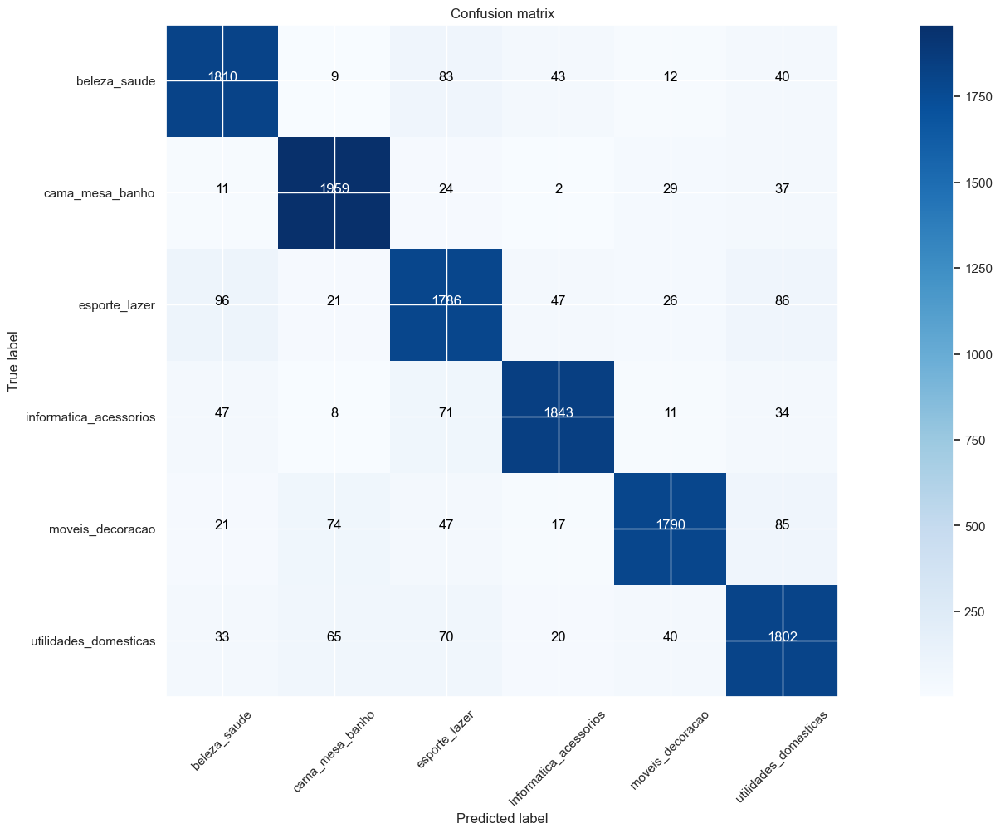

In [245]:
import matplotlib.pyplot as plt
from itertools import product
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import LabelEncoder


# encode class values as integers
encoder = LabelEncoder()
encoder.fit(y)
encoded_y= encoder.transform(y)

def plot_confusion_matrix(cm, classes,
                        normalize=False,
                        title='Confusion matrix',
                        cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
            horizontalalignment="center",
            color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    
cm = confusion_matrix(y_true=y_test, y_pred=bag.predict(X_test))
plot_confusion_matrix(cm, encoder.classes_,normalize=False,title='Confusion matrix',cmap=plt.cm.Blues)



In [246]:
# scores = cross_val_score(bag, X_train, y_train, cv=10)
# scores.mean()

In [247]:
from sklearn.ensemble import RandomForestClassifier

model = RandomForestClassifier(n_estimators=300, max_depth=None, min_samples_split=2, random_state=0).fit(X_train, y_train)
print("Random Forest Classifier - Training Set Accuracy:", model.score(X_train, y_train))
print("Random Forest Classifier - Test Set Accuracy:", model.score(X_test, y_test))

Random Forest Classifier - Training Set Accuracy: 1.0
Random Forest Classifier - Test Set Accuracy: 0.8536765308631855


In [248]:
model = ExtraTreesClassifier(n_estimators=300, max_depth=None, min_samples_split=2, random_state=0).fit(X_train, y_train)
print("Extra Trees  Classifier - Training Set Accuracy:", model.score(X_train, y_train))
print("Extra Trees Classifier - Test Set Accuracy:", model.score(X_test, y_test))

Extra Trees  Classifier - Training Set Accuracy: 1.0
Extra Trees Classifier - Test Set Accuracy: 0.7838347405525043


In [249]:
from sklearn.neighbors import KNeighborsClassifier
neigh = KNeighborsClassifier(n_neighbors=10)
neigh.fit(X_train, y_train)
print("KNN Training Set Accuracy:", neigh.score(X_train, y_train))
print("KNN Test Set Accuracy:", neigh.score(X_test, y_test))

/Users/aydensalazar/opt/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.



KNN Training Set Accuracy: 0.48475794403843825
KNN Test Set Accuracy: 0.3340437740798426


/Users/aydensalazar/opt/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.



In [250]:
from keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder


# encode class values as integers
encoder = LabelEncoder()
encoder.fit(y_train)
encoded_y_train = encoder.transform(y_train)

encoder = LabelEncoder()
encoder.fit(y_test)
encoded_y_test = encoder.transform(y_test)

y_train = to_categorical(encoded_y_train, 10)
y_test = to_categorical(encoded_y_test, 10)

In [251]:
from sklearn.feature_selection import SequentialFeatureSelector
from sympy import DenseNDimArray
from tensorflow import keras
from keras.layers import Dense
from keras.optimizers import SGD
from keras.models import Sequential

num_dim = X_train.shape[1]


model = tf.keras.models.Sequential()

#Initilize ANN
model = Sequential()

#Add input layer and fitst hidden layer
model.add(Dense(50, activation='relu', kernel_initializer='uniform', input_dim = num_dim))


#Add second hidden layer
model.add(Dense(50, activation='relu', kernel_initializer='uniform'))

# #Add third hidden layer
# model.add(Dense(50, activation='relu', kernel_initializer='uniform'))

#Add oupt layer
#model.add(Dense(10, activation = tf.nn.softmax, kernel_initializer='uniform'))
model.add(Dense(10, activation = tf.nn.softmax, kernel_initializer='uniform'))

#compiling ANN
#model.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = [metrics.categorical_accuracy])

sgd = SGD(0.005, momentum=0.0, nesterov=False)
model.compile(optimizer = sgd, loss = 'categorical_crossentropy', metrics = ['categorical_accuracy'])

# Fitting the ANN to the Training set
model.fit(X_train, y_train, batch_size = 10, epochs = 25, validation_split=0.1)

Epoch 1/25
2229/2229 [==============================] - 2s 613us/step - loss: 2.0846 - categorical_accuracy: 0.1751 - val_loss: 1.9527 - val_categorical_accuracy: 0.1857
Epoch 2/25
2229/2229 [==============================] - 1s 566us/step - loss: 1.8861 - categorical_accuracy: 0.2076 - val_loss: 1.8377 - val_categorical_accuracy: 0.2063
Epoch 3/25
2229/2229 [==============================] - 1s 557us/step - loss: 1.7956 - categorical_accuracy: 0.2632 - val_loss: 1.7370 - val_categorical_accuracy: 0.3032
Epoch 4/25
2229/2229 [==============================] - 1s 580us/step - loss: 1.6281 - categorical_accuracy: 0.3167 - val_loss: 1.5567 - val_categorical_accuracy: 0.3508
Epoch 5/25
2229/2229 [==============================] - 1s 577us/step - loss: 1.5158 - categorical_accuracy: 0.3582 - val_loss: 1.4874 - val_categorical_accuracy: 0.3633
Epoch 6/25
2229/2229 [==============================] - 1s 559us/step - loss: 1.4504 - categorical_accuracy: 0.3822 - val_loss: 1.4419 - val_categoric

In [252]:


model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Dense(50, input_dim=num_dim, activation='relu'))
model.add(tf.keras.layers.Dense(20, activation='relu'))
model.add(tf.keras.layers.Dense(20, activation='relu'))
model.add(tf.keras.layers.Dense(20, activation='relu'))
model.add(tf.keras.layers.Dense(20, activation='relu'))
model.add(tf.keras.layers.Dense(10, activation='softmax'))

model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

model.fit(X_train, y_train, batch_size = 10, epochs = 100, validation_split=0.1)

Epoch 1/100
2229/2229 [==============================] - 2s 797us/step - loss: 1.5502 - accuracy: 0.3563 - val_loss: 1.4262 - val_accuracy: 0.4203
Epoch 2/100
2229/2229 [==============================] - 2s 742us/step - loss: 1.3560 - accuracy: 0.4473 - val_loss: 1.3482 - val_accuracy: 0.4522
Epoch 3/100
2229/2229 [==============================] - 2s 741us/step - loss: 1.2917 - accuracy: 0.4835 - val_loss: 1.3140 - val_accuracy: 0.4768
Epoch 4/100
2229/2229 [==============================] - 2s 742us/step - loss: 1.2362 - accuracy: 0.5120 - val_loss: 1.2669 - val_accuracy: 0.5034
Epoch 5/100
2229/2229 [==============================] - 2s 746us/step - loss: 1.1976 - accuracy: 0.5309 - val_loss: 1.2658 - val_accuracy: 0.5131
Epoch 6/100
2229/2229 [==============================] - 2s 800us/step - loss: 1.1676 - accuracy: 0.5484 - val_loss: 1.2386 - val_accuracy: 0.5184
Epoch 7/100
2229/2229 [==============================] - 2s 742us/step - loss: 1.1442 - accuracy: 0.5568 - val_loss: 1

In [253]:
y_train

array([[0., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [254]:
X_train.shape

(24767, 76)

In [255]:
y_train.to_numpy()

AttributeError: 'numpy.ndarray' object has no attribute 'to_numpy'